In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        pass
print('hello')

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

hello


In [2]:
!pip install torch torchvision numpy opencv-python ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 977.1/977.1 kB 13.6 MB/s eta 0:00:00:00:01


In [3]:
# Clone YOLOv5 repo
!git clone https://github.com/ultralytics/yolov5.git
%cd yolov5
!pip install -r requirements.txt


Cloning into 'yolov5'...
remote: Enumerating objects: 17360, done.
remote: Counting objects: 100% (52/52), done.
remote: Compressing objects: 100% (34/34), done.
remote: Total 17360 (delta 36), reused 18 (delta 18), pack-reused 17308 (from 2)
Receiving objects: 100% (17360/17360), 16.25 MiB | 20.10 MiB/s, done.
Resolving deltas: 100% (11901/11901), done.
/kaggle/working/yolov5


In [4]:
import yaml

# Define the dataset configuration
voc_config = {
    "names": [
        "tvmonitor", "car", "dog", "person", "cow", "sofa", "sheep", "train", "aeroplane",
        "bottle", "cat", "bird", "diningtable", "chair", "motorbike", "horse",
        "pottedplant", "bus", "boat", "bicycle"
    ],
    "nc": 20,  # Number of classes
    "train": "/kaggle/input/yolo-dataset/train/images",
    "val": "/kaggle/input/yolo-dataset/val/images",
    "test": "/kaggle/input/yolo-dataset/test/images"
}

# Save YAML file
yaml_file_path = "/kaggle/working/voc.yaml"

with open(yaml_file_path, "w") as file:
    yaml.dump(voc_config, file, default_flow_style=False)

print(f"voc.yaml file created successfully at {yaml_file_path}")

voc.yaml file created successfully at /kaggle/working/voc.yaml


In [5]:
!python train.py --img 640 --batch 32 --epochs 15 --data /kaggle/working/voc.yaml --weights yolov5s.pt --cache

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2025-04-03 10:59:16.968077: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-04-03 10:59:17.145975: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-04-03 10:59:17.198708: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to regi

In [6]:
!python val.py --data /kaggle/working/voc.yaml --weights /kaggle/working/yolov5/runs/train/exp/weights/best.pt --img 640

val: data=/kaggle/working/voc.yaml, weights=['/kaggle/working/yolov5/runs/train/exp/weights/best.pt'], batch_size=32, imgsz=640, conf_thres=0.001, iou_thres=0.6, max_det=300, task=val, device=, workers=8, single_cls=False, augment=False, verbose=False, save_txt=False, save_hybrid=False, save_conf=False, save_json=False, project=runs/val, name=exp, exist_ok=False, half=False, dnn=False
YOLOv5 🚀 v7.0-411-gf4d8a84c Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)

Fusing layers... 
Model summary: 157 layers, 7064065 parameters, 0 gradients, 15.9 GFLOPs
val: Scanning /kaggle/input/yolo-dataset/val/labels... 3425 images, 0 background
val: WARNING ⚠️ Cache directory /kaggle/input/yolo-dataset/val is not writeable: [Errno 30] Read-only file system: '/kaggle/input/yolo-dataset/val/labels.cache.npy'
                 Class     Images  Instances          P          R      mAP50   
                   all       3425       8079      0.684      0.636       0.67      0.444
    

In [7]:
!python detect.py --weights /kaggle/working/yolov5/runs/train/exp/weights/best.pt --img 640 --conf 0.25 --source /kaggle/input/yolo-dataset/test/images

detect: weights=['/kaggle/working/yolov5/runs/train/exp/weights/best.pt'], source=/kaggle/input/yolo-dataset/test/images, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-411-gf4d8a84c Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)

Fusing layers... 
Model summary: 157 layers, 7064065 parameters, 0 gradients, 15.9 GFLOPs
image 1/1713 /kaggle/input/yolo-dataset/test/images/2007_000323.jpg: 480x640 2 persons, 30.4ms
image 2/1713 /kaggle/input/yolo-dataset/test/images/2007_000783.jpg: 608x640 1 person, 28.5ms
image 3/1713 /kaggle/input/yolo-dataset/test/images/2007_000793.jpg: 48

In [8]:
import shutil

# Define folder and zip paths
folder_path = "/kaggle/working/yolov5"
zip_path = "/kaggle/working/YoLoV5.zip"

# Zip the folder
shutil.make_archive(zip_path.replace(".zip", ""), 'zip', folder_path)

print(f"✅ Folder zipped successfully! You can now download {zip_path}")

✅ Folder zipped successfully! You can now download /kaggle/working/YoLoV5.zip


loading annotations into memory...
Done (t=0.44s)
creating index...
index created!


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:00<00:00, 187MB/s]  
Epoch 1/5: 100%|██████████| 2997/2997 [36:08<00:00,  1.38it/s, bbox_loss=0.226, cls_loss=0.698, total_loss=1.45]       


[Epoch 1] Loss: 934.2917 | Cls Loss: 110.9361 | BBox Loss: 22.1023
✅ Best model saved to /kaggle/working/fasterrcnn_best.pth


Epoch 2/5: 100%|██████████| 2997/2997 [34:26<00:00,  1.45it/s, bbox_loss=0.0992, cls_loss=0.217, total_loss=0.584]


[Epoch 2] Loss: 0.6971 | Cls Loss: 0.3173 | BBox Loss: 0.1222
✅ Best model saved to /kaggle/working/fasterrcnn_best.pth


Epoch 3/5: 100%|██████████| 2997/2997 [34:36<00:00,  1.44it/s, bbox_loss=0.0988, cls_loss=0.201, total_loss=0.611] 


[Epoch 3] Loss: 0.5819 | Cls Loss: 0.2277 | BBox Loss: 0.1240
✅ Best model saved to /kaggle/working/fasterrcnn_best.pth


Epoch 4/5: 100%|██████████| 2997/2997 [34:32<00:00,  1.45it/s, bbox_loss=0.0904, cls_loss=0.147, total_loss=0.362]  


[Epoch 4] Loss: 0.5738 | Cls Loss: 0.2214 | BBox Loss: 0.1227
✅ Best model saved to /kaggle/working/fasterrcnn_best.pth


Epoch 5/5: 100%|██████████| 2997/2997 [34:34<00:00,  1.44it/s, bbox_loss=0.08, cls_loss=0.12, total_loss=0.314]     


[Epoch 5] Loss: 0.5724 | Cls Loss: 0.2205 | BBox Loss: 0.1222
✅ Best model saved to /kaggle/working/fasterrcnn_best.pth
📊 Training results saved to `results.csv`


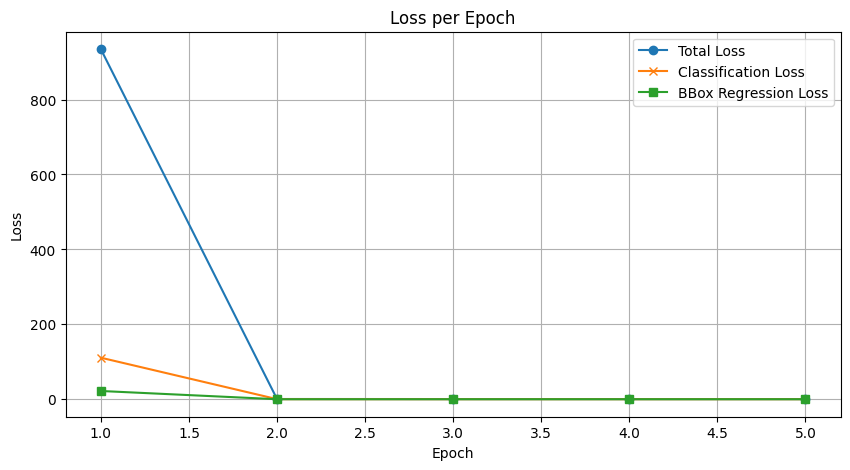

In [2]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch.optim as optim
import torch.nn as nn
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from torch.utils.data import DataLoader
from tqdm import tqdm
import os

# Set multiprocessing for CUDA
torch.multiprocessing.set_start_method('spawn', force=True)

# Device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Dataset
train_dataset = torchvision.datasets.CocoDetection(
    root="/kaggle/input/g2-project/output_dataset/images/train",
    annFile="/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_train.json",
    transform=transforms.ToTensor()
)

# Collate function
def collate_fn(batch):
    images, targets = zip(*batch)
    new_targets = []
    for t in targets:
        boxes, labels = [], []
        for ann in t:
            x_min, y_min, width, height = ann["bbox"]
            x_max, y_max = x_min + width, y_min + height
            if width > 0 and height > 0:
                boxes.append([x_min, y_min, x_max, y_max])
                labels.append(ann["category_id"])
        new_targets.append({
            "boxes": torch.tensor(boxes, dtype=torch.float32),
            "labels": torch.tensor(labels, dtype=torch.int64),
        })
    return list(images), new_targets

# Dataloader
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, collate_fn=collate_fn, num_workers=0)

# Model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, 21)
model.to(device)

# Optimizer & LR Scheduler
optimizer = optim.Adam(model.parameters(), lr=0.001)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

# Tracking
results = {"epoch": [], "loss": [], "cls_loss": [], "bbox_loss": []}
num_epochs = 5
best_loss = float("inf")

# Training
for epoch in range(num_epochs):
    model.train()
    total_loss, total_cls, total_bbox = 0, 0, 0
    progress_bar = tqdm(train_loader, desc=f"Epoch {epoch+1}/{num_epochs}")

    for images, targets in progress_bar:
        images = [img.to(device) for img in images]
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        optimizer.zero_grad()
        losses.backward()
        optimizer.step()

        total_loss += losses.item()
        total_cls += loss_dict['loss_classifier'].item()
        total_bbox += loss_dict['loss_box_reg'].item()

        progress_bar.set_postfix(
            total_loss=losses.item(),
            cls_loss=loss_dict['loss_classifier'].item(),
            bbox_loss=loss_dict['loss_box_reg'].item()
        )

    scheduler.step()
    avg_loss = total_loss / len(train_loader)
    avg_cls = total_cls / len(train_loader)
    avg_bbox = total_bbox / len(train_loader)

    print(f"[Epoch {epoch+1}] Loss: {avg_loss:.4f} | Cls Loss: {avg_cls:.4f} | BBox Loss: {avg_bbox:.4f}")

    # Log results
    results["epoch"].append(epoch + 1)
    results["loss"].append(avg_loss)
    results["cls_loss"].append(avg_cls)
    results["bbox_loss"].append(avg_bbox)

    # Save best model
    if avg_loss < best_loss:
        best_loss = avg_loss
        model_path = "/kaggle/working/fasterrcnn_best.pth"
        torch.save(model.state_dict(), model_path)
        print(f" Best model saved to {model_path}")

# Save CSV log
df = pd.DataFrame(results)
df.to_csv("/kaggle/working/results.csv", index=False)
print("📊 Training results saved to `results.csv`")

# Plot Losses
plt.figure(figsize=(10, 5))
plt.plot(df["epoch"], df["loss"], label="Total Loss", marker='o')
plt.plot(df["epoch"], df["cls_loss"], label="Classification Loss", marker='x')
plt.plot(df["epoch"], df["bbox_loss"], label="BBox Regression Loss", marker='s')
plt.title("Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.grid(True)
plt.savefig("/kaggle/working/training_loss_plot.png")
plt.show()


In [5]:
import torch
import torchvision
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from torch.utils.data import DataLoader
from tqdm import tqdm
from sklearn.metrics import precision_recall_curve, confusion_matrix, f1_score, average_precision_score
import torchvision.transforms.functional as F
from PIL import Image
import os

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load Validation Dataset
val_dataset = torchvision.datasets.CocoDetection(
    root="/kaggle/input/g2-project/output_dataset/images/val",
    annFile="/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_val.json",
    transform=torchvision.transforms.ToTensor()
)

# Custom collate function
def collate_fn(batch):
    images, targets = zip(*batch)
    images = [img.to(device) for img in images]
    
    new_targets = []
    for t in targets:
        boxes, labels = [], []
        for ann in t:
            x_min, y_min, width, height = ann["bbox"]
            x_max, y_max = x_min + width, y_min + height
            if width > 0 and height > 0:
                boxes.append([x_min, y_min, x_max, y_max])
                labels.append(ann["category_id"])
        
        new_targets.append({
            "boxes": torch.tensor(boxes, dtype=torch.float32).to(device),
            "labels": torch.tensor(labels, dtype=torch.int64).to(device),
        })
    
    return images, new_targets

# DataLoader (Batch Size = 4)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, collate_fn=collate_fn)

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except FileNotFoundError:
    print(f"❌ Model file not found at {model_path}! Please check your training step.")

model.to(device)
model.eval()

# Store results
results = {"image_id": [], "mAP50": [], "precision": [], "recall": [], "f1_score": []}

# Metrics storage
all_labels, all_scores, all_preds = [], [], []

with torch.no_grad():
    for images, targets in tqdm(val_loader, desc="Validating"):
        predictions = model(images)

        for i, prediction in enumerate(predictions):
            true_boxes = targets[i]["boxes"].cpu().numpy()
            true_labels = targets[i]["labels"].cpu().numpy()
            pred_boxes = prediction["boxes"].cpu().numpy()
            pred_scores = prediction["scores"].cpu().numpy()
            pred_labels = prediction["labels"].cpu().numpy()

            # Calculate Precision, Recall, and F1
            if len(true_labels) > 0 and len(pred_scores) > 0:
                precision, recall, _ = precision_recall_curve(true_labels, pred_scores)
                f1 = f1_score(true_labels, (pred_scores > 0.5).astype(int))
                mAP50 = average_precision_score(true_labels, pred_scores)  # Mean Average Precision at IoU=0.5
            else:
                precision, recall, f1, mAP50 = [0], [0], 0, 0  # Handle empty cases

            results["image_id"].append(i)
            results["precision"].append(np.mean(precision))
            results["recall"].append(np.mean(recall))
            results["f1_score"].append(f1)
            results["mAP50"].append(mAP50)

            # Store for confusion matrix & PR curve
            all_labels.extend(true_labels)
            all_preds.extend(pred_labels)
            all_scores.extend(pred_scores)

# Save results
results_df = pd.DataFrame(results)
results_df.to_csv("/kaggle/working/validation_results.csv", index=False)
print("✅ Validation results saved to `/kaggle/working/validation_results.csv`")

# # Plot PR Curve
# plt.figure(figsize=(7, 5))
# plt.plot(recall, precision, marker='o', linestyle='-', label="PR Curve")
# plt.xlabel("Recall")
# plt.ylabel("Precision")
# plt.title("Precision-Recall Curve")
# plt.legend()
# plt.grid()
# plt.savefig("/kaggle/working/pr_curve.png")
# plt.show()

# # Plot Confusion Matrix
# cm = confusion_matrix(all_labels, all_preds)
# plt.figure(figsize=(7, 5))
# sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
# plt.xlabel("Predicted")
# plt.ylabel("Actual")
# plt.title("Confusion Matrix")
# plt.savefig("/kaggle/working/confusion_matrix.png")
# plt.show()

# Create directory for validation output images
output_dir = "/kaggle/working/validation_output"
os.makedirs(output_dir, exist_ok=True)

with torch.no_grad():
    for batch_idx, (images, targets) in tqdm(enumerate(val_loader), desc="Saving Validation Images"):
        predictions = model(images)

        for i, (image, prediction, target) in enumerate(zip(images, predictions, targets)):
            # Convert image tensor to PIL format
            image = (image * 255).byte()  # Rescale tensor to 0-255
            image = F.to_pil_image(image.cpu())

            # Get predicted bounding boxes and labels
            pred_boxes = prediction["boxes"].cpu()
            pred_labels = prediction["labels"].cpu()
            pred_scores = prediction["scores"].cpu()

            # Get ground truth bounding boxes
            true_boxes = target["boxes"].cpu()
            true_labels = target["labels"].cpu()

            # Draw ground truth (in green) and predicted boxes (in red)
            image_with_boxes = torchvision.utils.draw_bounding_boxes(
                torchvision.transforms.ToTensor()(image),
                boxes=torch.cat([true_boxes, pred_boxes]),  # Combine ground truth & predictions
                labels=[f"GT-{l.item()}" for l in true_labels] + [f"Pred-{l.item()} ({s:.2f})" for l, s in zip(pred_labels, pred_scores)],
                colors=["green"] * len(true_boxes) + ["red"] * len(pred_boxes),
                width=2
            )

            # Convert back to PIL Image
            image_with_boxes = F.to_pil_image(image_with_boxes)

            # Save image
            img_path = os.path.join(output_dir, f"val_img_{batch_idx}_{i}.png")
            image_with_boxes.save(img_path)

print(f"✅ Validation images saved to {output_dir}")



loading annotations into memory...
Done (t=0.23s)
creating index...
index created!


<ipython-input-5-9b0cb89b30f7>:58: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth


Validating: 100%|██████████| 857/857 [04:27<00:00,  3.20it/s]


✅ Validation results saved to `/kaggle/working/validation_results.csv`


Saving Validation Images: 857it [08:35,  1.66it/s]

✅ Validation images saved to /kaggle/working/validation_output


In [6]:
import shutil

# Define folder and zip paths
folder_path = "/kaggle/working/validation_output"
zip_path = "/kaggle/working/validation_output.zip"

# Zip the folder
shutil.make_archive(zip_path.replace(".zip", ""), 'zip', folder_path)

print(f"✅ Folder zipped successfully! You can now download {zip_path}")

✅ Folder zipped successfully! You can now download /kaggle/working/validation_output.zip


In [15]:
import torch
import torchvision
import os
import cv2
import json
import numpy as np
from torch.utils.data import DataLoader
from tqdm import tqdm
import torchvision.transforms as transforms

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Paths
test_images_dir = "/kaggle/input/g2-project/output_dataset/images/test"
output_dir = "/kaggle/working/test_output"
annotations_file = "/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_test.json"

# Create output directory if not exists
os.makedirs(output_dir, exist_ok=True)

# Load image_id to filename mapping
with open(annotations_file, "r") as f:
    coco_data = json.load(f)

image_id_to_filename = {img["id"]: img["file_name"] for img in coco_data["images"]}

# Load Test Dataset
test_dataset = torchvision.datasets.CocoDetection(
    root=test_images_dir,
    annFile=annotations_file,
    transform=transforms.ToTensor()
)

# Custom collate function
def collate_fn(batch):
    images, targets = zip(*batch)
    image_ids = [target[0]["image_id"] if len(target) > 0 else -1 for target in targets]  # Extract image IDs
    images = [img.to(device) for img in images]
    return images, image_ids

# DataLoader
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False, collate_fn=collate_fn)

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except FileNotFoundError:
    print(f"❌ Model file not found at {model_path}! Please check your training step.")

model.to(device)
model.eval()

# Class labels mapping (Modify if needed)
class_labels = {i: f"Class_{i}" for i in range(num_classes)}

# Function to generate random colors for different classes
def random_color(seed):
    np.random.seed(seed)
    return tuple(np.random.randint(0, 255, 3).tolist())

# Inference & Save Outputs
with torch.no_grad():
    for images, image_ids in tqdm(test_loader, desc="Testing"):
        predictions = model(images)

        for i, prediction in enumerate(predictions):
            image_id = image_ids[i]

            if image_id == -1:
                print("⚠️ Warning: Missing annotations, skipping image.")
                continue
            
            # Get the actual image filename
            if image_id in image_id_to_filename:
                image_filename = image_id_to_filename[image_id]
                image_path = os.path.join(test_images_dir, image_filename)
            else:
                print(f"⚠️ Warning: Image ID {image_id} not found in dataset. Skipping.")
                continue
            
            output_path = os.path.join(output_dir, f"{image_filename}_pred.jpg")

            # Load original image
            if not os.path.exists(image_path):
                print(f"⚠️ Warning: Image {image_path} not found. Skipping.")
                continue

            image = cv2.imread(image_path)
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            # Get boxes, scores, and labels
            pred_boxes = prediction["boxes"].cpu().numpy()
            pred_scores = prediction["scores"].cpu().numpy()
            pred_labels = prediction["labels"].cpu().numpy()

            if len(pred_boxes) == 0:
                print(f"🔹 No objects detected in {image_filename}.")
                continue  # Skip if no detections

            print(f"🔍 Detected {len(pred_boxes)} objects in {image_filename}.")

            # Draw bounding boxes
            for j in range(len(pred_boxes)):
                if pred_scores[j] > 0.3:  # Confidence threshold
                    x_min, y_min, x_max, y_max = map(int, pred_boxes[j])
                    label = class_labels.get(pred_labels[j], "Unknown")
                    confidence = f"{pred_scores[j]:.2f}"
                    
                    # Generate class-specific color
                    color = random_color(pred_labels[j])

                    # Draw box
                    cv2.rectangle(image, (x_min, y_min), (x_max, y_max), color, 2)

                    # Draw filled rectangle for text background
                    (text_width, text_height), _ = cv2.getTextSize(f"{label} {confidence}", cv2.FONT_HERSHEY_SIMPLEX, 0.5, 2)
                    cv2.rectangle(image, (x_min, y_min - text_height - 5), (x_min + text_width, y_min), color, -1)

                    # Put text
                    cv2.putText(image, f"{label} {confidence}", (x_min, y_min - 5),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

            # Save output image
            cv2.imwrite(output_path, cv2.cvtColor(image, cv2.COLOR_RGB2BGR))

print(f"✅ Output images saved in: {output_dir}")


loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


<ipython-input-15-771c95f0f859>:54: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth


Testing:   0%|          | 1/429 [00:00<02:49,  2.52it/s]

🔹 No objects detected in 2008_005843.jpg.
🔹 No objects detected in 2009_003241.jpg.
🔹 No objects detected in 2011_000477.jpg.
🔹 No objects detected in 2008_003520.jpg.


Testing:   0%|          | 2/429 [00:00<02:36,  2.74it/s]

🔹 No objects detected in 2011_004042.jpg.
🔹 No objects detected in 2011_002581.jpg.
🔹 No objects detected in 2011_001479.jpg.
🔹 No objects detected in 2009_001124.jpg.


Testing:   1%|          | 3/429 [00:01<02:33,  2.78it/s]

🔹 No objects detected in 2011_005422.jpg.
🔹 No objects detected in 2011_004873.jpg.
🔹 No objects detected in 2010_003721.jpg.
🔹 No objects detected in 2009_000440.jpg.


Testing:   1%|          | 4/429 [00:01<02:21,  3.00it/s]

🔹 No objects detected in 2011_000404.jpg.
🔹 No objects detected in 2012_000748.jpg.
🔹 No objects detected in 2009_005126.jpg.
🔹 No objects detected in 2009_001412.jpg.


Testing:   1%|          | 5/429 [00:01<02:11,  3.23it/s]

🔹 No objects detected in 2010_005672.jpg.
🔹 No objects detected in 2008_003056.jpg.
🔹 No objects detected in 2009_003447.jpg.
🔹 No objects detected in 2011_006486.jpg.


Testing:   1%|▏         | 6/429 [00:02<02:21,  2.98it/s]

🔹 No objects detected in 2012_000513.jpg.
🔹 No objects detected in 2009_000727.jpg.
🔹 No objects detected in 2009_003857.jpg.
🔹 No objects detected in 2011_005898.jpg.


Testing:   2%|▏         | 7/429 [00:02<02:30,  2.81it/s]

🔹 No objects detected in 2011_002022.jpg.
🔹 No objects detected in 2009_000955.jpg.
🔹 No objects detected in 2011_005365.jpg.
🔹 No objects detected in 2008_006912.jpg.


Testing:   2%|▏         | 8/429 [00:02<02:20,  3.00it/s]

🔹 No objects detected in 2009_000022.jpg.
🔹 No objects detected in 2009_001055.jpg.
🔹 No objects detected in 2010_006275.jpg.
🔹 No objects detected in 2011_006262.jpg.


Testing:   2%|▏         | 9/429 [00:03<02:22,  2.95it/s]

🔹 No objects detected in 2010_005331.jpg.
🔹 No objects detected in 2009_002835.jpg.
🔹 No objects detected in 2010_002318.jpg.
🔹 No objects detected in 2009_001724.jpg.


Testing:   2%|▏         | 10/429 [00:03<02:29,  2.80it/s]

🔹 No objects detected in 2008_002983.jpg.
🔹 No objects detected in 2008_002649.jpg.
🔹 No objects detected in 2009_003372.jpg.
🔹 No objects detected in 2010_006234.jpg.


Testing:   3%|▎         | 11/429 [00:03<02:18,  3.02it/s]

🔹 No objects detected in 2011_002656.jpg.
🔹 No objects detected in 2008_005061.jpg.
🔹 No objects detected in 2011_006329.jpg.
🔹 No objects detected in 2011_006825.jpg.


Testing:   3%|▎         | 12/429 [00:04<02:21,  2.95it/s]

🔹 No objects detected in 2008_003331.jpg.
🔹 No objects detected in 2008_002294.jpg.
🔹 No objects detected in 2011_005844.jpg.
🔹 No objects detected in 2012_002833.jpg.


Testing:   3%|▎         | 13/429 [00:04<02:19,  2.98it/s]

🔹 No objects detected in 2011_002981.jpg.
🔹 No objects detected in 2011_000725.jpg.
🔹 No objects detected in 2008_006028.jpg.
🔹 No objects detected in 2008_007730.jpg.


Testing:   3%|▎         | 14/429 [00:04<02:24,  2.88it/s]

🔹 No objects detected in 2010_003800.jpg.
🔹 No objects detected in 2010_000351.jpg.
🔹 No objects detected in 2010_003375.jpg.
🔹 No objects detected in 2008_003196.jpg.


Testing:   3%|▎         | 15/429 [00:05<02:26,  2.83it/s]

🔹 No objects detected in 2010_001795.jpg.
🔹 No objects detected in 2010_000109.jpg.
🔹 No objects detected in 2009_004987.jpg.
🔹 No objects detected in 2011_000345.jpg.


Testing:   4%|▎         | 16/429 [00:05<02:14,  3.08it/s]

🔹 No objects detected in 2008_003093.jpg.
🔹 No objects detected in 2008_002920.jpg.
🔹 No objects detected in 2009_003560.jpg.
🔹 No objects detected in 2010_001838.jpg.


Testing:   4%|▍         | 17/429 [00:05<02:16,  3.01it/s]

🔹 No objects detected in 2009_001028.jpg.
🔹 No objects detected in 2008_006792.jpg.
🔹 No objects detected in 2009_003023.jpg.
🔹 No objects detected in 2011_001655.jpg.


Testing:   4%|▍         | 18/429 [00:06<02:11,  3.12it/s]

🔹 No objects detected in 2008_000236.jpg.
🔹 No objects detected in 2010_000241.jpg.
🔹 No objects detected in 2008_003291.jpg.
🔹 No objects detected in 2008_004274.jpg.


Testing:   4%|▍         | 19/429 [00:06<02:17,  2.98it/s]

🔹 No objects detected in 2011_004898.jpg.
🔹 No objects detected in 2008_005758.jpg.
🔹 No objects detected in 2009_002096.jpg.
🔹 No objects detected in 2008_000461.jpg.


Testing:   5%|▍         | 20/429 [00:06<02:18,  2.96it/s]

🔹 No objects detected in 2007_001609.jpg.
🔹 No objects detected in 2011_000315.jpg.
🔹 No objects detected in 2011_003357.jpg.
🔹 No objects detected in 2009_001706.jpg.


Testing:   5%|▍         | 21/429 [00:07<02:19,  2.93it/s]

🔹 No objects detected in 2011_001606.jpg.
🔹 No objects detected in 2008_006752.jpg.
🔹 No objects detected in 2011_000949.jpg.
🔹 No objects detected in 2008_000806.jpg.


Testing:   5%|▌         | 22/429 [00:07<02:18,  2.94it/s]

🔹 No objects detected in 2010_004515.jpg.
🔹 No objects detected in 2008_001245.jpg.
🔹 No objects detected in 2012_002265.jpg.
🔹 No objects detected in 2010_005094.jpg.


Testing:   5%|▌         | 23/429 [00:07<02:10,  3.11it/s]

🔹 No objects detected in 2008_007738.jpg.
🔹 No objects detected in 2010_000897.jpg.
🔹 No objects detected in 2010_005374.jpg.
🔹 No objects detected in 2008_003099.jpg.


Testing:   6%|▌         | 24/429 [00:08<02:04,  3.25it/s]

🔹 No objects detected in 2010_005683.jpg.
🔹 No objects detected in 2012_001749.jpg.
🔹 No objects detected in 2008_006397.jpg.
🔹 No objects detected in 2011_002380.jpg.


Testing:   6%|▌         | 25/429 [00:08<02:00,  3.35it/s]

🔹 No objects detected in 2008_006598.jpg.
🔹 No objects detected in 2009_004919.jpg.
🔹 No objects detected in 2012_003869.jpg.
🔹 No objects detected in 2010_002561.jpg.


Testing:   6%|▌         | 26/429 [00:08<01:55,  3.50it/s]

🔹 No objects detected in 2008_000833.jpg.
🔹 No objects detected in 2008_006663.jpg.
🔹 No objects detected in 2010_006358.jpg.
🔹 No objects detected in 2007_004112.jpg.


Testing:   6%|▋         | 27/429 [00:08<01:53,  3.53it/s]

🔹 No objects detected in 2009_001327.jpg.
🔹 No objects detected in 2011_001949.jpg.
🔹 No objects detected in 2009_004764.jpg.
🔹 No objects detected in 2008_006120.jpg.


Testing:   7%|▋         | 28/429 [00:09<01:52,  3.55it/s]

🔹 No objects detected in 2009_003255.jpg.
🔹 No objects detected in 2009_003018.jpg.
🔹 No objects detected in 2008_003041.jpg.
🔹 No objects detected in 2010_003146.jpg.


Testing:   7%|▋         | 29/429 [00:09<01:54,  3.49it/s]

🔹 No objects detected in 2008_006909.jpg.
🔹 No objects detected in 2012_000298.jpg.
🔹 No objects detected in 2008_005082.jpg.
🔹 No objects detected in 2009_002626.jpg.


Testing:   7%|▋         | 30/429 [00:09<01:56,  3.43it/s]

🔹 No objects detected in 2011_001163.jpg.
🔹 No objects detected in 2010_003351.jpg.
🔹 No objects detected in 2009_001345.jpg.
🔹 No objects detected in 2012_002165.jpg.


Testing:   7%|▋         | 31/429 [00:10<01:59,  3.32it/s]

🔹 No objects detected in 2007_002643.jpg.
🔹 No objects detected in 2008_004307.jpg.
🔹 No objects detected in 2008_007390.jpg.
🔹 No objects detected in 2011_002775.jpg.


Testing:   7%|▋         | 32/429 [00:10<01:57,  3.37it/s]

🔹 No objects detected in 2008_002957.jpg.
🔹 No objects detected in 2011_000559.jpg.
🔹 No objects detected in 2010_001142.jpg.
🔹 No objects detected in 2009_004982.jpg.


Testing:   8%|▊         | 33/429 [00:10<02:06,  3.12it/s]

🔹 No objects detected in 2008_002676.jpg.
🔹 No objects detected in 2011_005012.jpg.
🔹 No objects detected in 2008_006558.jpg.
🔹 No objects detected in 2011_003259.jpg.


Testing:   8%|▊         | 34/429 [00:10<02:02,  3.22it/s]

🔹 No objects detected in 2009_000858.jpg.
🔹 No objects detected in 2010_000177.jpg.
🔹 No objects detected in 2008_000573.jpg.
🔹 No objects detected in 2010_006890.jpg.


Testing:   8%|▊         | 35/429 [00:11<01:58,  3.33it/s]

🔹 No objects detected in 2012_003783.jpg.
🔹 No objects detected in 2007_007330.jpg.
🔹 No objects detected in 2011_005492.jpg.
🔹 No objects detected in 2008_004054.jpg.


Testing:   8%|▊         | 36/429 [00:11<01:58,  3.31it/s]

🔹 No objects detected in 2009_002131.jpg.
🔹 No objects detected in 2009_002970.jpg.
🔹 No objects detected in 2011_001206.jpg.
🔹 No objects detected in 2011_000412.jpg.


Testing:   9%|▊         | 37/429 [00:11<02:12,  2.97it/s]

🔹 No objects detected in 2010_002870.jpg.
🔹 No objects detected in 2012_003670.jpg.
🔹 No objects detected in 2010_002779.jpg.
🔹 No objects detected in 2011_000395.jpg.


Testing:   9%|▉         | 38/429 [00:12<02:04,  3.15it/s]

🔹 No objects detected in 2011_003304.jpg.
🔹 No objects detected in 2009_002571.jpg.
🔹 No objects detected in 2008_007256.jpg.
🔹 No objects detected in 2011_001320.jpg.


Testing:   9%|▉         | 39/429 [00:12<02:06,  3.07it/s]

🔹 No objects detected in 2010_005725.jpg.
🔹 No objects detected in 2008_004923.jpg.
🔹 No objects detected in 2008_005379.jpg.
🔹 No objects detected in 2012_000031.jpg.


Testing:   9%|▉         | 40/429 [00:12<02:05,  3.10it/s]

🔹 No objects detected in 2010_003014.jpg.
🔹 No objects detected in 2010_004363.jpg.
🔹 No objects detected in 2011_002676.jpg.
🔹 No objects detected in 2008_000758.jpg.


Testing:  10%|▉         | 41/429 [00:13<02:08,  3.03it/s]

🔹 No objects detected in 2009_000410.jpg.
🔹 No objects detected in 2011_006237.jpg.
🔹 No objects detected in 2011_001986.jpg.
🔹 No objects detected in 2008_000669.jpg.


Testing:  10%|▉         | 42/429 [00:13<02:11,  2.93it/s]

🔹 No objects detected in 2008_002099.jpg.
🔹 No objects detected in 2009_005019.jpg.
🔹 No objects detected in 2008_003542.jpg.
🔹 No objects detected in 2011_002644.jpg.


Testing:  10%|█         | 43/429 [00:14<02:16,  2.82it/s]

🔹 No objects detected in 2008_007237.jpg.
🔹 No objects detected in 2009_003156.jpg.
🔹 No objects detected in 2008_008525.jpg.
🔹 No objects detected in 2009_002621.jpg.


Testing:  10%|█         | 44/429 [00:14<02:19,  2.77it/s]

🔹 No objects detected in 2010_005897.jpg.
🔹 No objects detected in 2010_000033.jpg.
🔹 No objects detected in 2011_005248.jpg.
🔹 No objects detected in 2010_002750.jpg.


Testing:  10%|█         | 45/429 [00:14<02:16,  2.82it/s]

🔹 No objects detected in 2008_007938.jpg.
🔹 No objects detected in 2012_003386.jpg.
🔹 No objects detected in 2008_002094.jpg.
🔹 No objects detected in 2007_001397.jpg.


Testing:  11%|█         | 46/429 [00:15<02:16,  2.80it/s]

🔹 No objects detected in 2012_000753.jpg.
🔹 No objects detected in 2009_002652.jpg.
🔹 No objects detected in 2010_006551.jpg.
🔹 No objects detected in 2008_003141.jpg.


Testing:  11%|█         | 47/429 [00:15<02:18,  2.77it/s]

🔹 No objects detected in 2011_004462.jpg.
🔹 No objects detected in 2011_006368.jpg.
🔹 No objects detected in 2012_003535.jpg.
🔹 No objects detected in 2009_000939.jpg.


Testing:  11%|█         | 48/429 [00:15<02:08,  2.97it/s]

🔹 No objects detected in 2009_004890.jpg.
🔹 No objects detected in 2009_005168.jpg.
🔹 No objects detected in 2011_004526.jpg.
🔹 No objects detected in 2010_002048.jpg.


Testing:  11%|█▏        | 49/429 [00:16<02:04,  3.04it/s]

🔹 No objects detected in 2009_001407.jpg.
🔹 No objects detected in 2008_005097.jpg.
🔹 No objects detected in 2008_006778.jpg.
🔹 No objects detected in 2010_001264.jpg.


Testing:  12%|█▏        | 50/429 [00:16<02:08,  2.95it/s]

🔹 No objects detected in 2007_003131.jpg.
🔹 No objects detected in 2009_003517.jpg.
🔹 No objects detected in 2011_001117.jpg.
🔹 No objects detected in 2012_003328.jpg.


Testing:  12%|█▏        | 51/429 [00:16<01:58,  3.18it/s]

🔹 No objects detected in 2011_001705.jpg.
🔹 No objects detected in 2012_001321.jpg.
🔹 No objects detected in 2012_001611.jpg.
🔹 No objects detected in 2009_000041.jpg.


Testing:  12%|█▏        | 52/429 [00:16<01:57,  3.22it/s]

🔹 No objects detected in 2008_004786.jpg.
🔹 No objects detected in 2010_006731.jpg.
🔹 No objects detected in 2011_006367.jpg.
🔹 No objects detected in 2009_001016.jpg.


Testing:  12%|█▏        | 53/429 [00:17<02:00,  3.11it/s]

🔹 No objects detected in 2009_001042.jpg.
🔹 No objects detected in 2008_007875.jpg.
🔹 No objects detected in 2011_000341.jpg.
🔹 No objects detected in 2009_003642.jpg.


Testing:  13%|█▎        | 54/429 [00:17<01:56,  3.23it/s]

🔹 No objects detected in 2010_002552.jpg.
🔹 No objects detected in 2010_000740.jpg.
🔹 No objects detected in 2009_004721.jpg.
🔹 No objects detected in 2008_007012.jpg.


Testing:  13%|█▎        | 55/429 [00:17<01:53,  3.30it/s]

🔹 No objects detected in 2011_002280.jpg.
🔹 No objects detected in 2011_006893.jpg.
🔹 No objects detected in 2008_008192.jpg.
🔹 No objects detected in 2010_002390.jpg.


Testing:  13%|█▎        | 56/429 [00:18<01:57,  3.17it/s]

🔹 No objects detected in 2012_004129.jpg.
🔹 No objects detected in 2008_001013.jpg.
🔹 No objects detected in 2010_002789.jpg.
🔹 No objects detected in 2008_000839.jpg.


Testing:  13%|█▎        | 57/429 [00:18<01:58,  3.14it/s]

🔹 No objects detected in 2008_005517.jpg.
🔹 No objects detected in 2008_005296.jpg.
🔹 No objects detected in 2008_005325.jpg.
🔹 No objects detected in 2012_003220.jpg.


Testing:  14%|█▎        | 58/429 [00:18<01:54,  3.25it/s]

🔹 No objects detected in 2008_000863.jpg.
🔹 No objects detected in 2011_005478.jpg.
🔹 No objects detected in 2010_000538.jpg.
🔹 No objects detected in 2008_003213.jpg.


Testing:  14%|█▍        | 59/429 [00:19<01:52,  3.30it/s]

🔹 No objects detected in 2008_007977.jpg.
🔹 No objects detected in 2008_008506.jpg.
🔹 No objects detected in 2009_001163.jpg.
🔹 No objects detected in 2008_001135.jpg.


Testing:  14%|█▍        | 60/429 [00:19<01:58,  3.11it/s]

🔹 No objects detected in 2008_002123.jpg.
🔹 No objects detected in 2011_001928.jpg.
🔹 No objects detected in 2012_000404.jpg.
🔹 No objects detected in 2010_006627.jpg.


Testing:  14%|█▍        | 61/429 [00:19<01:53,  3.23it/s]

🔹 No objects detected in 2007_001764.jpg.
🔹 No objects detected in 2007_000904.jpg.
🔹 No objects detected in 2008_000817.jpg.
🔹 No objects detected in 2011_002726.jpg.


Testing:  14%|█▍        | 62/429 [00:20<01:48,  3.39it/s]

🔹 No objects detected in 2012_000035.jpg.
🔹 No objects detected in 2008_000062.jpg.
🔹 No objects detected in 2010_004922.jpg.
🔹 No objects detected in 2009_000992.jpg.


Testing:  15%|█▍        | 63/429 [00:20<02:00,  3.03it/s]

🔹 No objects detected in 2009_004994.jpg.
🔹 No objects detected in 2010_003890.jpg.
🔹 No objects detected in 2011_000575.jpg.
🔹 No objects detected in 2011_004602.jpg.


Testing:  15%|█▍        | 64/429 [00:20<01:53,  3.23it/s]

🔹 No objects detected in 2010_001061.jpg.
🔹 No objects detected in 2011_005316.jpg.
🔹 No objects detected in 2012_003090.jpg.
🔹 No objects detected in 2009_002681.jpg.


Testing:  15%|█▌        | 65/429 [00:21<01:56,  3.12it/s]

🔹 No objects detected in 2010_006097.jpg.
🔹 No objects detected in 2011_005554.jpg.
🔹 No objects detected in 2011_006173.jpg.
🔹 No objects detected in 2012_001082.jpg.


Testing:  15%|█▌        | 66/429 [00:21<01:56,  3.11it/s]

🔹 No objects detected in 2010_003956.jpg.
🔹 No objects detected in 2010_002248.jpg.
🔹 No objects detected in 2012_003922.jpg.
🔹 No objects detected in 2010_005542.jpg.
🔹 No objects detected in 2011_002561.jpg.
🔹 No objects detected in 2011_002620.jpg.


Testing:  16%|█▌        | 67/429 [00:22<02:42,  2.22it/s]

🔹 No objects detected in 2011_004927.jpg.
🔹 No objects detected in 2011_004418.jpg.


Testing:  16%|█▌        | 68/429 [00:22<02:32,  2.36it/s]

🔹 No objects detected in 2008_003384.jpg.
🔹 No objects detected in 2009_001329.jpg.
🔹 No objects detected in 2010_004145.jpg.
🔹 No objects detected in 2011_002398.jpg.


Testing:  16%|█▌        | 69/429 [00:22<02:19,  2.58it/s]

🔹 No objects detected in 2009_000387.jpg.
🔹 No objects detected in 2008_004854.jpg.
🔹 No objects detected in 2008_002647.jpg.
🔹 No objects detected in 2008_005599.jpg.


Testing:  16%|█▋        | 70/429 [00:23<02:08,  2.80it/s]

🔹 No objects detected in 2008_007761.jpg.
🔹 No objects detected in 2007_007996.jpg.
🔹 No objects detected in 2011_003642.jpg.
🔹 No objects detected in 2011_005863.jpg.


Testing:  17%|█▋        | 71/429 [00:23<02:12,  2.71it/s]

🔹 No objects detected in 2008_005166.jpg.
🔹 No objects detected in 2008_007006.jpg.
🔹 No objects detected in 2008_007043.jpg.
🔹 No objects detected in 2008_008519.jpg.


Testing:  17%|█▋        | 72/429 [00:23<02:12,  2.70it/s]

🔹 No objects detected in 2011_003764.jpg.
🔹 No objects detected in 2011_002147.jpg.
🔹 No objects detected in 2009_003855.jpg.
🔹 No objects detected in 2008_002868.jpg.


Testing:  17%|█▋        | 73/429 [00:24<02:03,  2.88it/s]

🔹 No objects detected in 2009_002506.jpg.
🔹 No objects detected in 2011_000362.jpg.
🔹 No objects detected in 2009_001375.jpg.
🔹 No objects detected in 2011_006648.jpg.


Testing:  17%|█▋        | 74/429 [00:24<01:53,  3.12it/s]

🔹 No objects detected in 2010_004030.jpg.
🔹 No objects detected in 2008_003329.jpg.
🔹 No objects detected in 2012_001796.jpg.
🔹 No objects detected in 2012_004083.jpg.


Testing:  17%|█▋        | 75/429 [00:24<01:48,  3.27it/s]

🔹 No objects detected in 2008_001660.jpg.
🔹 No objects detected in 2011_003103.jpg.
🔹 No objects detected in 2010_001344.jpg.
🔹 No objects detected in 2009_004763.jpg.


Testing:  18%|█▊        | 76/429 [00:25<01:59,  2.95it/s]

🔹 No objects detected in 2010_004447.jpg.
🔹 No objects detected in 2010_002242.jpg.
🔹 No objects detected in 2008_005105.jpg.
🔹 No objects detected in 2011_004617.jpg.


Testing:  18%|█▊        | 77/429 [00:25<01:53,  3.10it/s]

🔹 No objects detected in 2007_009684.jpg.
🔹 No objects detected in 2011_002980.jpg.
🔹 No objects detected in 2008_001750.jpg.
🔹 No objects detected in 2009_002697.jpg.


Testing:  18%|█▊        | 78/429 [00:25<01:55,  3.04it/s]

🔹 No objects detected in 2011_004096.jpg.
🔹 No objects detected in 2011_003571.jpg.
🔹 No objects detected in 2011_006448.jpg.
🔹 No objects detected in 2012_000059.jpg.


Testing:  18%|█▊        | 79/429 [00:26<01:58,  2.96it/s]

🔹 No objects detected in 2011_000789.jpg.
🔹 No objects detected in 2009_003800.jpg.
🔹 No objects detected in 2008_003745.jpg.
🔹 No objects detected in 2009_000928.jpg.


Testing:  19%|█▊        | 80/429 [00:26<01:52,  3.11it/s]

🔹 No objects detected in 2011_001637.jpg.
🔹 No objects detected in 2009_004188.jpg.
🔹 No objects detected in 2009_002833.jpg.
🔹 No objects detected in 2008_000956.jpg.


Testing:  19%|█▉        | 81/429 [00:26<01:51,  3.12it/s]

🔹 No objects detected in 2009_003818.jpg.
🔹 No objects detected in 2009_003944.jpg.
🔹 No objects detected in 2009_002958.jpg.
🔹 No objects detected in 2011_004073.jpg.


Testing:  19%|█▉        | 82/429 [00:27<01:58,  2.93it/s]

🔹 No objects detected in 2009_003267.jpg.
🔹 No objects detected in 2010_003303.jpg.
🔹 No objects detected in 2009_002397.jpg.
🔹 No objects detected in 2008_000406.jpg.


Testing:  19%|█▉        | 83/429 [00:27<01:55,  3.01it/s]

🔹 No objects detected in 2010_003645.jpg.
🔹 No objects detected in 2010_000577.jpg.
🔹 No objects detected in 2008_001390.jpg.
🔹 No objects detected in 2009_000726.jpg.


Testing:  20%|█▉        | 84/429 [00:27<01:55,  2.98it/s]

🔹 No objects detected in 2008_007486.jpg.
🔹 No objects detected in 2011_004705.jpg.
🔹 No objects detected in 2009_001481.jpg.
🔹 No objects detected in 2009_004709.jpg.


Testing:  20%|█▉        | 85/429 [00:28<01:49,  3.13it/s]

🔹 No objects detected in 2011_003789.jpg.
🔹 No objects detected in 2008_008574.jpg.
🔹 No objects detected in 2012_004077.jpg.
🔹 No objects detected in 2009_001555.jpg.


Testing:  20%|██        | 86/429 [00:28<01:46,  3.23it/s]

🔹 No objects detected in 2008_007661.jpg.
🔹 No objects detected in 2008_001301.jpg.
🔹 No objects detected in 2011_003712.jpg.
🔹 No objects detected in 2011_002269.jpg.


Testing:  20%|██        | 87/429 [00:28<01:43,  3.30it/s]

🔹 No objects detected in 2009_004438.jpg.
🔹 No objects detected in 2010_003132.jpg.
🔹 No objects detected in 2009_003212.jpg.
🔹 No objects detected in 2008_005092.jpg.


Testing:  21%|██        | 88/429 [00:28<01:45,  3.23it/s]

🔹 No objects detected in 2011_003055.jpg.
🔹 No objects detected in 2011_006102.jpg.
🔹 No objects detected in 2008_002017.jpg.
🔹 No objects detected in 2007_008647.jpg.


Testing:  21%|██        | 89/429 [00:29<01:50,  3.07it/s]

🔹 No objects detected in 2009_001453.jpg.
🔹 No objects detected in 2007_005173.jpg.
🔹 No objects detected in 2009_005038.jpg.
🔹 No objects detected in 2007_003682.jpg.


Testing:  21%|██        | 90/429 [00:29<01:56,  2.91it/s]

🔹 No objects detected in 2010_001753.jpg.
🔹 No objects detected in 2010_004982.jpg.
🔹 No objects detected in 2011_001873.jpg.
🔹 No objects detected in 2009_002182.jpg.


Testing:  21%|██        | 91/429 [00:30<01:59,  2.83it/s]

🔹 No objects detected in 2008_000188.jpg.
🔹 No objects detected in 2012_004034.jpg.
🔹 No objects detected in 2009_001054.jpg.
🔹 No objects detected in 2010_006117.jpg.


Testing:  21%|██        | 91/429 [00:30<01:52,  3.00it/s]


KeyboardInterrupt: 

In [16]:
import torch
import torchvision
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from torch.utils.data import DataLoader
from tqdm import tqdm
from PIL import Image
import os
import torchvision.transforms.functional as F
from sklearn.metrics import precision_recall_curve, confusion_matrix, f1_score, average_precision_score

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load Test Dataset
test_dataset = torchvision.datasets.CocoDetection(
    root="/kaggle/input/g2-project/output_dataset/images/test",
    annFile="/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_test.json",
    transform=torchvision.transforms.ToTensor()
)

# Custom collate function for DataLoader
def collate_fn(batch):
    images, targets = zip(*batch)
    images = [img.to(device) for img in images]
    
    new_targets = []
    for t in targets:
        boxes, labels = [], []
        for ann in t:
            x_min, y_min, width, height = ann["bbox"]
            x_max, y_max = x_min + width, y_min + height
            if width > 0 and height > 0:
                boxes.append([x_min, y_min, x_max, y_max])
                labels.append(ann["category_id"])
        
        new_targets.append({
            "boxes": torch.tensor(boxes, dtype=torch.float32).to(device),
            "labels": torch.tensor(labels, dtype=torch.int64).to(device),
        })
    
    return images, new_targets

# DataLoader (Batch Size = 4)
test_loader = DataLoader(test_dataset, batch_size=4, shuffle=False, collate_fn=collate_fn)

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except FileNotFoundError:
    print(f"❌ Model file not found at {model_path}! Please check your training step.")

model.to(device)
model.eval()

# Store results
results = {"image_id": [], "mAP50": [], "precision": [], "recall": [], "f1_score": []}

# Metrics storage
all_labels, all_scores, all_preds = [], [], []

CONFIDENCE_THRESHOLD = 0.3  # Adjust threshold if needed

with torch.no_grad():
    for images, targets in tqdm(test_loader, desc="Testing"):
        predictions = model(images)

        for i, prediction in enumerate(predictions):
            true_boxes = targets[i]["boxes"].cpu().numpy()
            true_labels = targets[i]["labels"].cpu().numpy()
            pred_boxes = prediction["boxes"].cpu().numpy()
            pred_scores = prediction["scores"].cpu().numpy()
            pred_labels = prediction["labels"].cpu().numpy()

            # Calculate Precision, Recall, and F1
            if len(true_labels) > 0 and len(pred_scores) > 0:
                precision, recall, _ = precision_recall_curve(true_labels, pred_scores)
                f1 = f1_score(true_labels, (pred_scores > CONFIDENCE_THRESHOLD).astype(int))
                mAP50 = average_precision_score(true_labels, pred_scores)  # Mean Average Precision at IoU=0.5
            else:
                precision, recall, f1, mAP50 = [0], [0], 0, 0  # Handle empty cases

            results["image_id"].append(i)
            results["precision"].append(np.mean(precision))
            results["recall"].append(np.mean(recall))
            results["f1_score"].append(f1)
            results["mAP50"].append(mAP50)

            # Store for confusion matrix & PR curve
            all_labels.extend(true_labels)
            all_preds.extend(pred_labels)
            all_scores.extend(pred_scores)

# Save results
results_df = pd.DataFrame(results)
results_df.to_csv("/kaggle/working/test_results.csv", index=False)
print("✅ Test results saved to `/kaggle/working/test_results.csv`")

# # Plot PR Curve
# plt.figure(figsize=(7, 5))
# plt.plot(recall, precision, marker='o', linestyle='-', label="PR Curve")
# plt.xlabel("Recall")
# plt.ylabel("Precision")
# plt.title("Precision-Recall Curve")
# plt.legend()
# plt.grid()
# plt.savefig("/kaggle/working/test_pr_curve.png")
# plt.show()

# # Plot Confusion Matrix
# cm = confusion_matrix(all_labels, all_preds)
# plt.figure(figsize=(7, 5))
# sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
# plt.xlabel("Predicted")
# plt.ylabel("Actual")
# plt.title("Confusion Matrix")
# plt.savefig("/kaggle/working/test_confusion_matrix.png")
# plt.show()

# Create directory for test output images
output_dir = "/kaggle/working/test_output"
os.makedirs(output_dir, exist_ok=True)

with torch.no_grad():
    for batch_idx, (images, targets) in tqdm(enumerate(test_loader), desc="Saving Test Images"):
        predictions = model(images)

        for i, (image, prediction, target) in enumerate(zip(images, predictions, targets)):
            # Convert image tensor to PIL format
            image = (image * 255).byte()  # Rescale tensor to 0-255
            image = F.to_pil_image(image.cpu())

            # Get predicted bounding boxes and labels
            pred_boxes = prediction["boxes"].cpu()
            pred_labels = prediction["labels"].cpu()
            pred_scores = prediction["scores"].cpu()

            # Get ground truth bounding boxes
            true_boxes = target["boxes"].cpu()
            true_labels = target["labels"].cpu()

            # Draw ground truth (green) and predicted boxes (red)
            image_with_boxes = torchvision.utils.draw_bounding_boxes(
                torchvision.transforms.ToTensor()(image),
                boxes=torch.cat([true_boxes, pred_boxes]),  # Combine ground truth & predictions
                labels=[f"GT-{l.item()}" for l in true_labels] + [f"Pred-{l.item()} ({s:.2f})" for l, s in zip(pred_labels, pred_scores)],
                colors=["green"] * len(true_boxes) + ["red"] * len(pred_boxes),
                width=2
            )

            # Convert back to PIL Image
            image_with_boxes = F.to_pil_image(image_with_boxes)

            # Save image
            img_path = os.path.join(output_dir, f"test_img_{batch_idx}_{i}.png")
            image_with_boxes.save(img_path)

print(f"✅ Test images saved to {output_dir}")


loading annotations into memory...
Done (t=0.03s)
creating index...
index created!


<ipython-input-16-6f69c5871fec>:58: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth


Testing: 100%|██████████| 429/429 [02:14<00:00,  3.19it/s]


✅ Test results saved to `/kaggle/working/test_results.csv`


Saving Test Images: 429it [04:12,  1.70it/s]

✅ Test images saved to /kaggle/working/test_output


Using device: cuda


<ipython-input-22-ec1d509e642e>:22: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


Model loaded successfully from /kaggle/working/fasterrcnn_best.pth
Categories: {1: 'tvmonitor', 2: 'car', 3: 'dog', 4: 'person', 5: 'cow', 6: 'sofa', 7: 'sheep', 8: 'train', 9: 'aeroplane', 10: 'bottle', 11: 'cat', 12: 'bird', 13: 'diningtable', 14: 'chair', 15: 'motorbike', 16: 'horse', 17: 'pottedplant', 18: 'bus', 19: 'boat', 20: 'bicycle'}
Processing image: /kaggle/input/g2-project/output_dataset/images/test/2007_000783.jpg


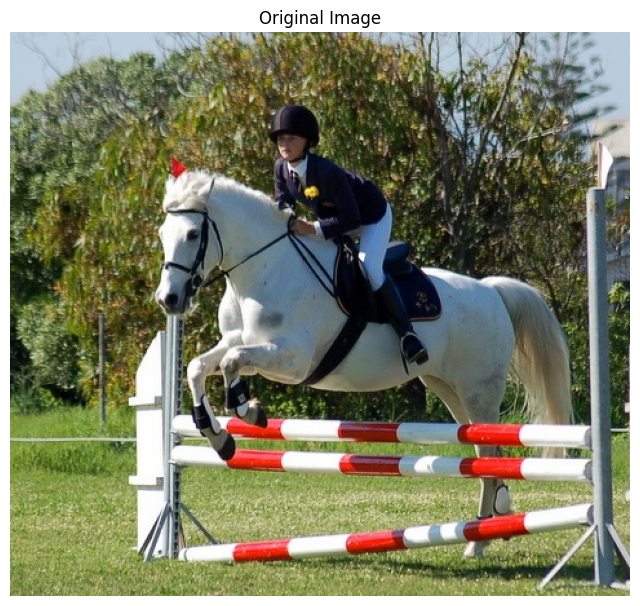

Image dimensions: 480x437
Running inference...
Number of detected boxes: 0

Raw prediction details:

Detections with threshold 0.01: 0


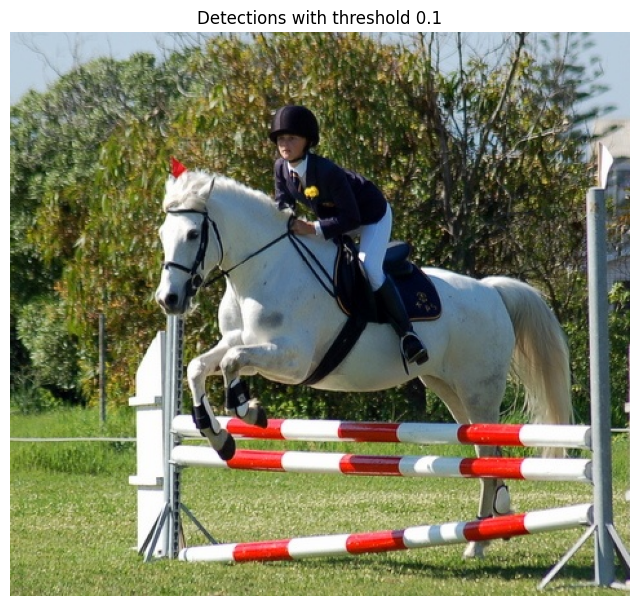


Detections with threshold 0.3: 0


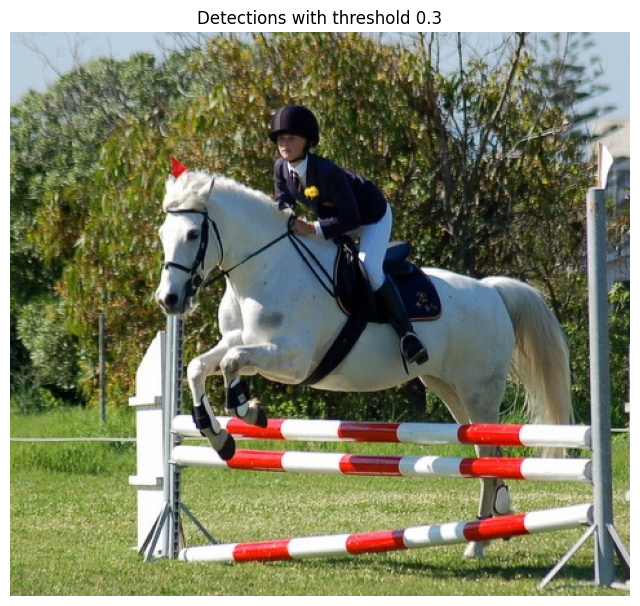


Checking for invalid predictions...


In [22]:
import torch
import torchvision.transforms as transforms
import torchvision
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import json
import numpy as np

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained weights
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"Model loaded successfully from {model_path}")
except Exception as e:
    print(f"Error loading model: {e}")
    
model.to(device)
model.eval()

# Load category information from COCO annotations
try:
    with open("/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_train.json", 'r') as f:
        coco_data = json.load(f)
    
    # Create category ID to name mapping
    categories = {cat['id']: cat['name'] for cat in coco_data['categories']}
    print(f"Categories: {categories}")
except Exception as e:
    print(f"Error loading categories: {e}")
    # Fallback to generic labels
    categories = {i: f"Class {i}" for i in range(1, 21)}

# Image path
image_path = "/kaggle/input/g2-project/output_dataset/images/test/2007_000783.jpg"
print(f"Processing image: {image_path}")

# Load and display original image
image = Image.open(image_path).convert("RGB")
plt.figure(figsize=(8, 8))
plt.imshow(image)
plt.title("Original Image")
plt.axis("off")
plt.show()

# Get image dimensions
width, height = image.size
print(f"Image dimensions: {width}x{height}")

# Apply exactly the same transformations as during training
transform = transforms.Compose([
    transforms.ToTensor()  # Match training transform
])

# Transform image and move to device
image_tensor = transform(image).unsqueeze(0).to(device)

# Perform inference with detailed logging
print("Running inference...")
with torch.no_grad():
    prediction = model(image_tensor)[0]

# Print detailed prediction information
print(f"Number of detected boxes: {len(prediction['boxes'])}")
if len(prediction['boxes']) > 0:
    print(f"Scores range: {prediction['scores'].min().item():.4f} to {prediction['scores'].max().item():.4f}")
    
print("\nRaw prediction details:")
for i in range(min(len(prediction['boxes']), 10)):  # Show first 10 predictions
    box = prediction['boxes'][i].cpu().numpy()
    score = prediction['scores'][i].item()
    label = prediction['labels'][i].item()
    label_name = categories.get(label, f"Unknown ({label})")
    print(f"Detection {i+1}: {label_name} (ID: {label}) with confidence {score:.4f}, box: {box}")

# Try multiple confidence thresholds
for threshold in [0.01, 0.05, 0.1, 0.3]:
    # Filter predictions based on confidence threshold
    indices = [i for i, score in enumerate(prediction['scores']) if score >= threshold]
    filtered_boxes = prediction['boxes'][indices].cpu().numpy() if indices else []
    filtered_labels = prediction['labels'][indices].cpu().numpy() if indices else []
    filtered_scores = prediction['scores'][indices].cpu().numpy() if indices else []
    
    print(f"\nDetections with threshold {threshold}: {len(filtered_boxes)}")
    
    # Create a copy of the image for this threshold
    image_with_boxes = image.copy()
    draw = ImageDraw.Draw(image_with_boxes)
    
    # Draw bounding boxes on the image
    for box, label_id, score in zip(filtered_boxes, filtered_labels, filtered_scores):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label_id.item(), f"Unknown ({label_id})")
        
        # Draw rectangle
        draw.rectangle([(x_min, y_min), (x_max, y_max)], outline="red", width=2)
        
        # Draw label text
        text = f"{label_name}: {score:.2f}"
        draw.text((x_min, y_min-15), text, fill="red")
    
    # Show the image with detections
    plt.figure(figsize=(8, 8))
    plt.imshow(image_with_boxes)
    plt.title(f"Detections with threshold {threshold}")
    plt.axis("off")
    plt.show()

# Additional debug: Check if boxes are completely outside image bounds
print("\nChecking for invalid predictions...")
for i in range(len(prediction['boxes'])):
    box = prediction['boxes'][i].cpu().numpy()
    x_min, y_min, x_max, y_max = box
    
    # Check if box is outside image bounds or improperly sized
    if x_min < 0 or y_min < 0 or x_max > width or y_max > height:
        print(f"Box {i+1} is outside image bounds: {box}")
    if x_max <= x_min or y_max <= y_min:
        print(f"Box {i+1} has invalid dimensions: {box}")

In [23]:
import torch
import torchvision
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from torch.utils.data import DataLoader
from tqdm import tqdm
from sklearn.metrics import precision_recall_curve, confusion_matrix, f1_score, average_precision_score
import torchvision.transforms.functional as F
from PIL import Image
import os

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Load Validation Dataset
val_dataset = torchvision.datasets.CocoDetection(
    root="/kaggle/input/g2-project/output_dataset/images/test",
    annFile="/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_test.json",
    transform=torchvision.transforms.ToTensor()
)

# Custom collate function
def collate_fn(batch):
    images, targets = zip(*batch)
    images = [img.to(device) for img in images]
    
    new_targets = []
    for t in targets:
        boxes, labels = [], []
        for ann in t:
            x_min, y_min, width, height = ann["bbox"]
            x_max, y_max = x_min + width, y_min + height
            if width > 0 and height > 0:
                boxes.append([x_min, y_min, x_max, y_max])
                labels.append(ann["category_id"])
        
        new_targets.append({
            "boxes": torch.tensor(boxes, dtype=torch.float32).to(device),
            "labels": torch.tensor(labels, dtype=torch.int64).to(device),
        })
    
    return images, new_targets

# DataLoader (Batch Size = 4)
val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False, collate_fn=collate_fn)

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except FileNotFoundError:
    print(f"❌ Model file not found at {model_path}! Please check your training step.")

model.to(device)
model.eval()

# Store results
results = {"image_id": [], "mAP50": [], "precision": [], "recall": [], "f1_score": []}

# Metrics storage
all_labels, all_scores, all_preds = [], [], []

with torch.no_grad():
    for images, targets in tqdm(val_loader, desc="Validating"):
        predictions = model(images)

        for i, prediction in enumerate(predictions):
            true_boxes = targets[i]["boxes"].cpu().numpy()
            true_labels = targets[i]["labels"].cpu().numpy()
            pred_boxes = prediction["boxes"].cpu().numpy()
            pred_scores = prediction["scores"].cpu().numpy()
            pred_labels = prediction["labels"].cpu().numpy()

            # Calculate Precision, Recall, and F1
            if len(true_labels) > 0 and len(pred_scores) > 0:
                precision, recall, _ = precision_recall_curve(true_labels, pred_scores)
                f1 = f1_score(true_labels, (pred_scores > 0.5).astype(int))
                mAP50 = average_precision_score(true_labels, pred_scores)  # Mean Average Precision at IoU=0.5
            else:
                precision, recall, f1, mAP50 = [0], [0], 0, 0  # Handle empty cases

            results["image_id"].append(i)
            results["precision"].append(np.mean(precision))
            results["recall"].append(np.mean(recall))
            results["f1_score"].append(f1)
            results["mAP50"].append(mAP50)

            # Store for confusion matrix & PR curve
            all_labels.extend(true_labels)
            all_preds.extend(pred_labels)
            all_scores.extend(pred_scores)

# Save results
results_df = pd.DataFrame(results)
results_df.to_csv("/kaggle/working/TEST_results.csv", index=False)
print("✅ TEST results saved to `/kaggle/working/TEST_results.csv`")

# # Plot PR Curve
# plt.figure(figsize=(7, 5))
# plt.plot(recall, precision, marker='o', linestyle='-', label="PR Curve")
# plt.xlabel("Recall")
# plt.ylabel("Precision")
# plt.title("Precision-Recall Curve")
# plt.legend()
# plt.grid()
# plt.savefig("/kaggle/working/pr_curve.png")
# plt.show()

# # Plot Confusion Matrix
# cm = confusion_matrix(all_labels, all_preds)
# plt.figure(figsize=(7, 5))
# sns.heatmap(cm, annot=True, fmt="d", cmap="Blues")
# plt.xlabel("Predicted")
# plt.ylabel("Actual")
# plt.title("Confusion Matrix")
# plt.savefig("/kaggle/working/confusion_matrix.png")
# plt.show()

# Create directory for validation output images
output_dir = "/kaggle/working/TEST_output"
os.makedirs(output_dir, exist_ok=True)

with torch.no_grad():
    for batch_idx, (images, targets) in tqdm(enumerate(val_loader), desc="Saving TESTING Images"):
        predictions = model(images)

        for i, (image, prediction, target) in enumerate(zip(images, predictions, targets)):
            # Convert image tensor to PIL format
            image = (image * 255).byte()  # Rescale tensor to 0-255
            image = F.to_pil_image(image.cpu())

            # Get predicted bounding boxes and labels
            pred_boxes = prediction["boxes"].cpu()
            pred_labels = prediction["labels"].cpu()
            pred_scores = prediction["scores"].cpu()

            # Get ground truth bounding boxes
            true_boxes = target["boxes"].cpu()
            true_labels = target["labels"].cpu()

            # Draw ground truth (in green) and predicted boxes (in red)
            image_with_boxes = torchvision.utils.draw_bounding_boxes(
                torchvision.transforms.ToTensor()(image),
                boxes=torch.cat([true_boxes, pred_boxes]),  # Combine ground truth & predictions
                labels=[f"GT-{l.item()}" for l in true_labels] + [f"Pred-{l.item()} ({s:.2f})" for l, s in zip(pred_labels, pred_scores)],
                colors=["green"] * len(true_boxes) + ["red"] * len(pred_boxes),
                width=2
            )

            # Convert back to PIL Image
            image_with_boxes = F.to_pil_image(image_with_boxes)

            # Save image
            img_path = os.path.join(output_dir, f"test_img_{batch_idx}_{i}.png")
            image_with_boxes.save(img_path)

print(f"✅ TESTING images saved to {output_dir}")



loading annotations into memory...
Done (t=0.02s)
creating index...
index created!


<ipython-input-23-c710013fba2a>:58: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth


Validating: 100%|██████████| 429/429 [02:19<00:00,  3.08it/s]


✅ TEST results saved to `/kaggle/working/TEST_results.csv`


Saving TESTING Images: 429it [04:20,  1.65it/s]

✅ TESTING images saved to /kaggle/working/TEST_output


Using device: cuda
Categories: {1: 'tvmonitor', 2: 'car', 3: 'dog', 4: 'person', 5: 'cow', 6: 'sofa', 7: 'sheep', 8: 'train', 9: 'aeroplane', 10: 'bottle', 11: 'cat', 12: 'bird', 13: 'diningtable', 14: 'chair', 15: 'motorbike', 16: 'horse', 17: 'pottedplant', 18: 'bus', 19: 'boat', 20: 'bicycle'}


<ipython-input-25-0c3259186eb9>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth
Processing image: /kaggle/input/g2-project/output_dataset/images/test/2007_000793.jpg


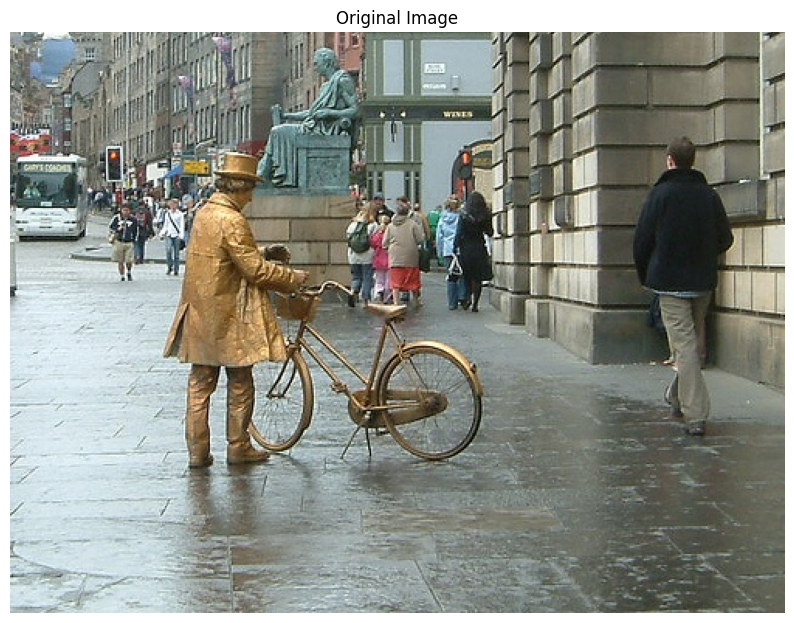

Found 10 ground truth annotations
Raw predictions: 0 boxes detected

All predictions (top 10):

After filtering (threshold=0.01): 0 boxes


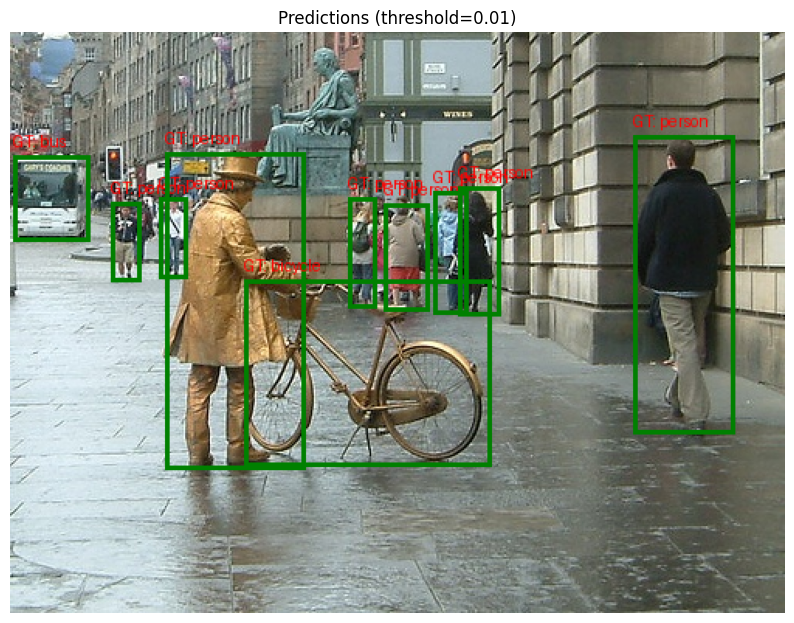

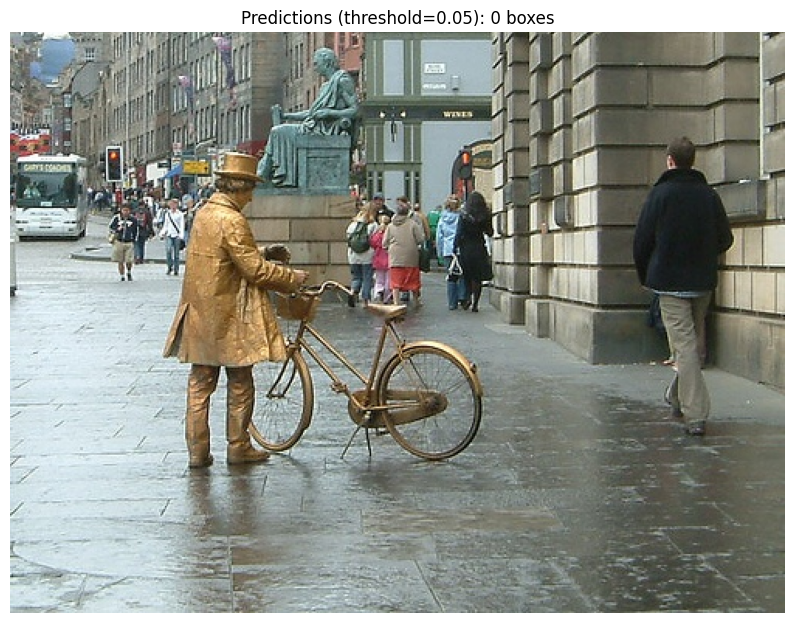

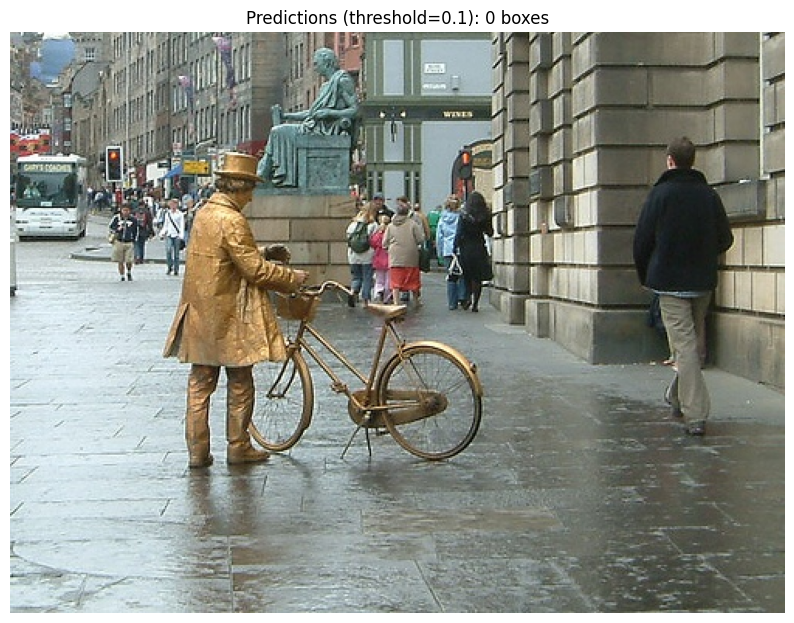

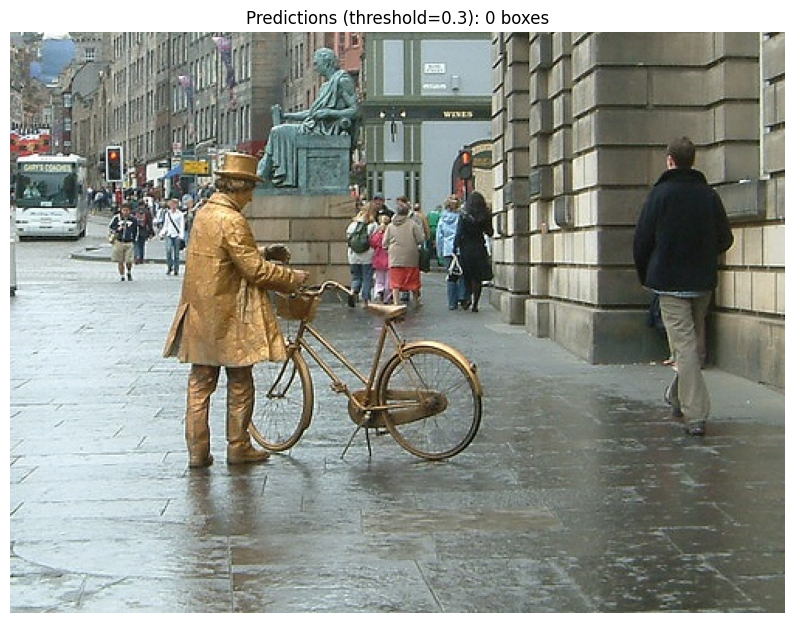


Model inspection:
Number of classes: 21
Score threshold: 0.05
NMS threshold: 0.5
Detections per image: 100

RoI Box Predictor:
FastRCNNPredictor(
  (cls_score): Linear(in_features=1024, out_features=21, bias=True)
  (bbox_pred): Linear(in_features=1024, out_features=84, bias=True)
)


In [25]:
import torch
import torchvision
import torchvision.transforms.functional as F
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import json
import numpy as np
import os

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load category information from COCO annotations
try:
    with open("/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_test.json", 'r') as f:
        coco_data = json.load(f)
    
    # Create category ID to name mapping
    categories = {cat['id']: cat['name'] for cat in coco_data['categories']}
    print(f"Categories: {categories}")
except Exception as e:
    print(f"Error loading categories: {e}")
    # Fallback to generic labels
    categories = {i: f"Class {i}" for i in range(1, 21)}

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except Exception as e:
    print(f"❌ Error loading model: {e}")

model.to(device)
model.eval()

# Function to process a single image
def process_single_image(image_path, confidence_threshold=0.5):
    print(f"Processing image: {image_path}")
    
    # Load image
    image = Image.open(image_path).convert("RGB")
    
    # Display original image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")
    plt.show()
    
    # Get ground truth annotations (if available)
    image_id = os.path.basename(image_path).split('.')[0]  # Assuming filename is the image_id
    gt_boxes = []
    gt_labels = []
    
    try:
        # Find annotations for this image
        image_info = next((img for img in coco_data['images'] if img['file_name'].endswith(f"{image_id}.jpg")), None)
        if image_info:
            image_id_int = image_info['id']
            annotations = [ann for ann in coco_data['annotations'] if ann['image_id'] == image_id_int]
            
            for ann in annotations:
                x, y, w, h = ann['bbox']
                gt_boxes.append([x, y, x+w, y+h])
                gt_labels.append(ann['category_id'])
            
            print(f"Found {len(annotations)} ground truth annotations")
    except Exception as e:
        print(f"Could not load ground truth annotations: {e}")
    
    # Apply transformations
    transform = torchvision.transforms.ToTensor()
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    # Run inference
    with torch.no_grad():
        prediction = model(image_tensor)[0]
    
    # Print prediction stats
    pred_boxes = prediction['boxes'].cpu().numpy()
    pred_scores = prediction['scores'].cpu().numpy()
    pred_labels = prediction['labels'].cpu().numpy()
    
    print(f"Raw predictions: {len(pred_boxes)} boxes detected")
    
    # Show all predictions regardless of confidence
    print("\nAll predictions (top 10):")
    for i in range(min(10, len(pred_boxes))):
        label_id = pred_labels[i]
        label_name = categories.get(label_id, f"Class {label_id}")
        print(f"Box {i+1}: {label_name} (ID: {label_id}) - Score: {pred_scores[i]:.4f} - Coords: {pred_boxes[i]}")
    
    # Filter by confidence threshold
    filtered_indices = np.where(pred_scores >= confidence_threshold)[0]
    filtered_boxes = pred_boxes[filtered_indices]
    filtered_scores = pred_scores[filtered_indices]
    filtered_labels = pred_labels[filtered_indices]
    
    print(f"\nAfter filtering (threshold={confidence_threshold}): {len(filtered_boxes)} boxes")
    
    # Create a PIL image for drawing boxes
    result_img = image.copy()
    draw = ImageDraw.Draw(result_img)
    
    # Draw ground truth boxes in green
    for box, label in zip(gt_boxes, gt_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="green", width=3)
        draw.text((x_min, y_min-15), f"GT: {label_name}", fill="red")
    
    # Draw predicted boxes in red
    for box, score, label in zip(filtered_boxes, filtered_scores, filtered_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
        draw.text((x_min, y_min-15), f"Pred: {label_name} ({score:.2f})", fill="red")
    
    # Show the result
    plt.figure(figsize=(10, 10))
    plt.imshow(result_img)
    plt.title(f"Predictions (threshold={confidence_threshold})")
    plt.axis("off")
    plt.show()
    
    # Try multiple thresholds
    for threshold in [0.05, 0.1, 0.3]:
        if threshold == confidence_threshold:
            continue
            
        indices = np.where(pred_scores >= threshold)[0]
        boxes = pred_boxes[indices]
        scores = pred_scores[indices]
        labels = pred_labels[indices]
        
        # Create a new image for this threshold
        threshold_img = image.copy()
        draw = ImageDraw.Draw(threshold_img)
        
        # Draw boxes
        for box, score, label in zip(boxes, scores, labels):
            x_min, y_min, x_max, y_max = box
            label_name = categories.get(label, f"Class {label}")
            draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
            draw.text((x_min, y_min-15), f"{label_name} ({score:.2f})", fill="red")
        
        # Show the result
        plt.figure(figsize=(10, 10))
        plt.imshow(threshold_img)
        plt.title(f"Predictions (threshold={threshold}): {len(boxes)} boxes")
        plt.axis("off")
        plt.show()
    
    return prediction

# Image path - replace with your actual test image path
image_path = "/kaggle/input/g2-project/output_dataset/images/test/2007_000793.jpg"

# Process the image with a low threshold to see all potential detections
results = process_single_image(image_path, confidence_threshold=0.01)

# Additional model inspection
print("\nModel inspection:")
print(f"Number of classes: {num_classes}")
print(f"Score threshold: {model.roi_heads.score_thresh}")
print(f"NMS threshold: {model.roi_heads.nms_thresh}")
print(f"Detections per image: {model.roi_heads.detections_per_img}")

# Check the box predictor and classifier
print("\nRoI Box Predictor:")
print(model.roi_heads.box_predictor)

Using device: cuda
Categories: {1: 'tvmonitor', 2: 'car', 3: 'dog', 4: 'person', 5: 'cow', 6: 'sofa', 7: 'sheep', 8: 'train', 9: 'aeroplane', 10: 'bottle', 11: 'cat', 12: 'bird', 13: 'diningtable', 14: 'chair', 15: 'motorbike', 16: 'horse', 17: 'pottedplant', 18: 'bus', 19: 'boat', 20: 'bicycle'}


<ipython-input-32-4d921ef0f140>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth
Processing image: /kaggle/input/g2-project/output_dataset/images/test/2007_000323.jpg


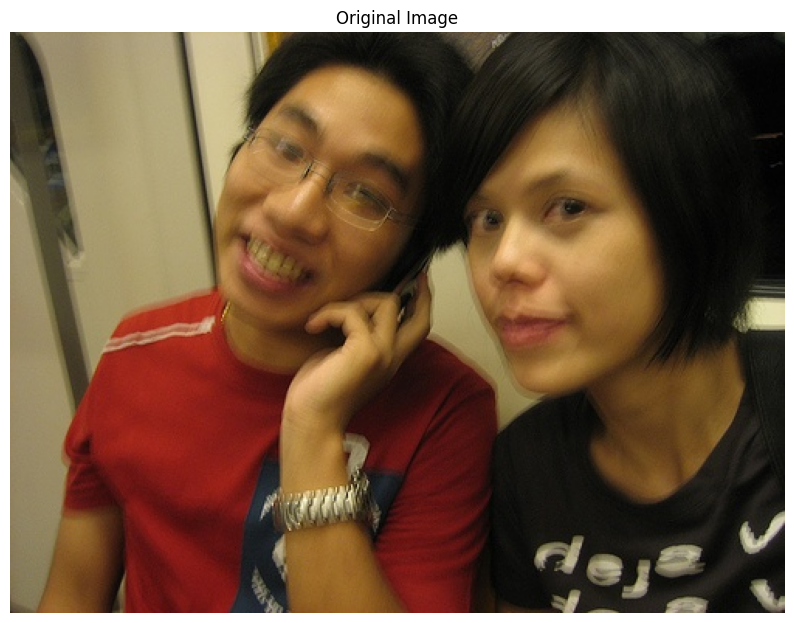

Found 2 ground truth annotations
Raw predictions: 0 boxes detected

All predictions (top 10):

After filtering (threshold=0.01): 0 boxes


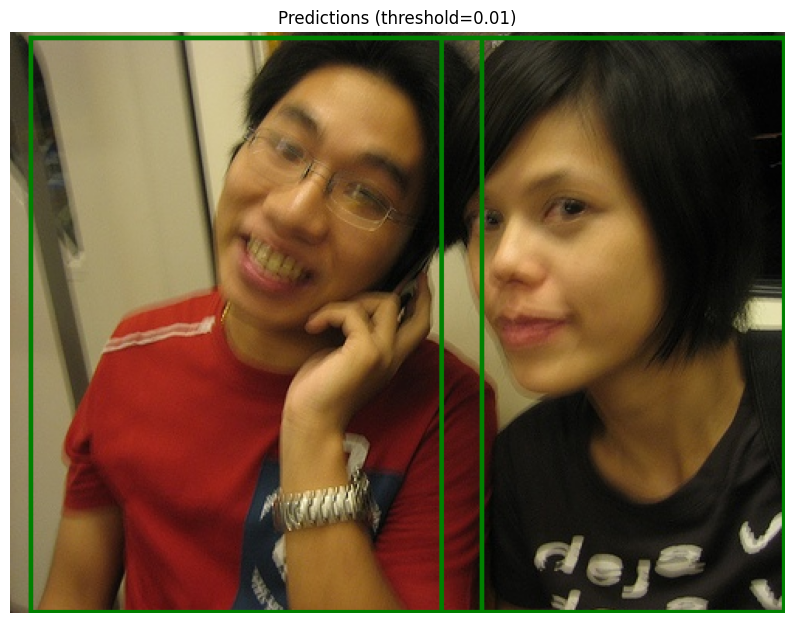

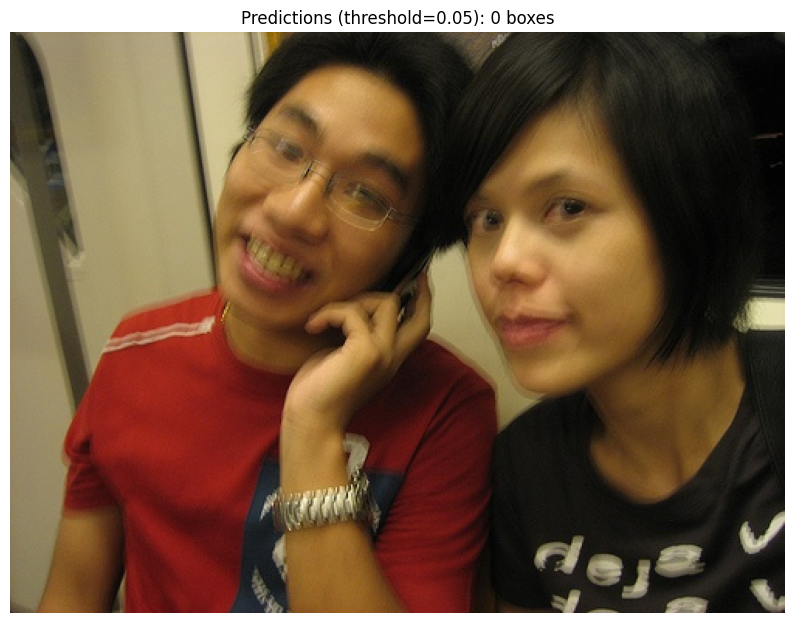

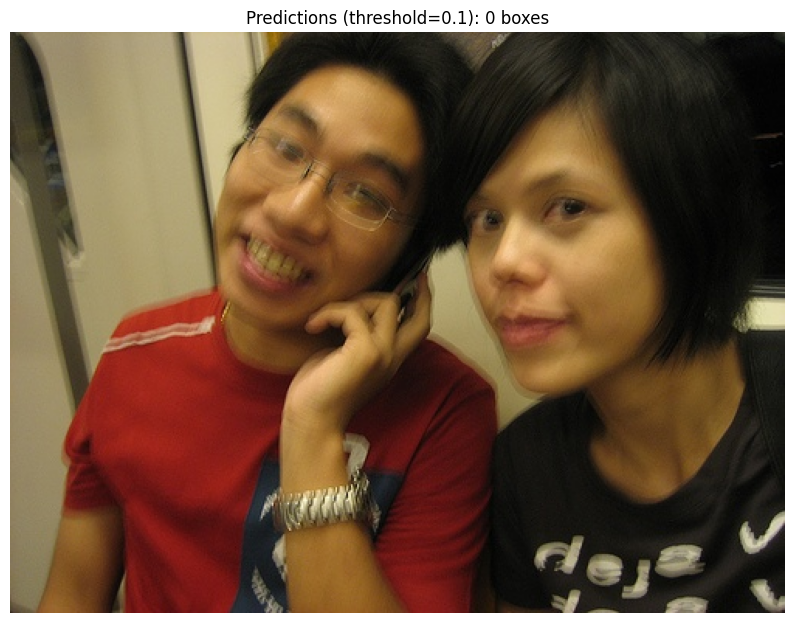

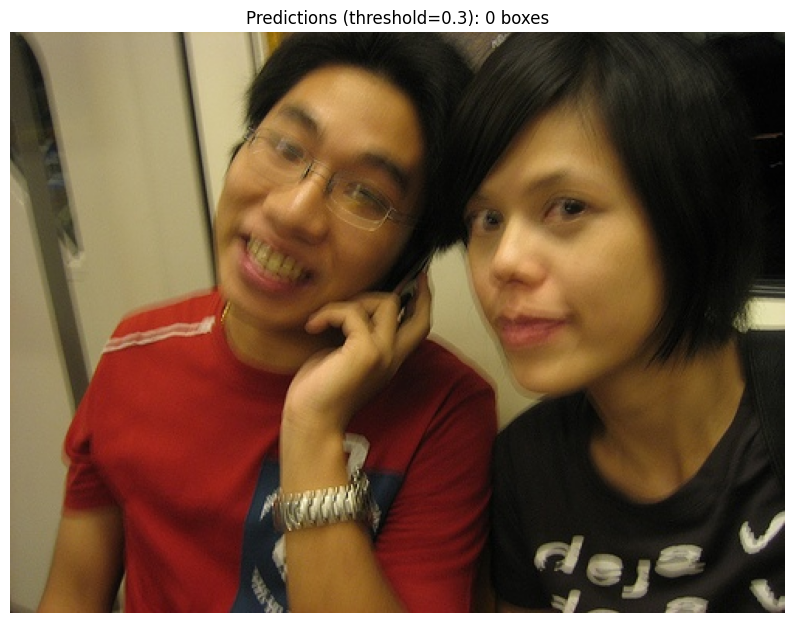


Model inspection:
Number of classes: 21
Score threshold: 0.05
NMS threshold: 0.5
Detections per image: 100

RoI Box Predictor:
FastRCNNPredictor(
  (cls_score): Linear(in_features=1024, out_features=21, bias=True)
  (bbox_pred): Linear(in_features=1024, out_features=84, bias=True)
)


In [32]:
import torch
import torchvision
import torchvision.transforms.functional as F
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import json
import numpy as np
import os

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load category information from COCO annotations
try:
    with open("/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_test.json", 'r') as f:
        coco_data = json.load(f)
    
    # Create category ID to name mapping
    categories = {cat['id']: cat['name'] for cat in coco_data['categories']}
    print(f"Categories: {categories}")
except Exception as e:
    print(f"Error loading categories: {e}")
    # Fallback to generic labels
    categories = {i: f"Class {i}" for i in range(1, 21)}

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except Exception as e:
    print(f"❌ Error loading model: {e}")

model.to(device)
model.eval()

# Function to process a single image
def process_single_image(image_path, confidence_threshold=0.5):
    print(f"Processing image: {image_path}")
    
    # Load image
    image = Image.open(image_path).convert("RGB")
    
    # Display original image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")
    plt.show()
    
    # Get ground truth annotations (if available)
    image_id = os.path.basename(image_path).split('.')[0]  # Assuming filename is the image_id
    gt_boxes = []
    gt_labels = []
    
    try:
        # Find annotations for this image
        image_info = next((img for img in coco_data['images'] if img['file_name'].endswith(f"{image_id}.jpg")), None)
        if image_info:
            image_id_int = image_info['id']
            annotations = [ann for ann in coco_data['annotations'] if ann['image_id'] == image_id_int]
            
            for ann in annotations:
                x, y, w, h = ann['bbox']
                gt_boxes.append([x, y, x+w, y+h])
                gt_labels.append(ann['category_id'])
            
            print(f"Found {len(annotations)} ground truth annotations")
    except Exception as e:
        print(f"Could not load ground truth annotations: {e}")
    
    # Apply transformations
    transform = torchvision.transforms.ToTensor()
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    # Run inference
    with torch.no_grad():
        prediction = model(image_tensor)[0]
    
    # Print prediction stats
    pred_boxes = prediction['boxes'].cpu().numpy()
    pred_scores = prediction['scores'].cpu().numpy()
    pred_labels = prediction['labels'].cpu().numpy()
    
    print(f"Raw predictions: {len(pred_boxes)} boxes detected")
    
    # Show all predictions regardless of confidence
    print("\nAll predictions (top 10):")
    for i in range(min(10, len(pred_boxes))):
        label_id = pred_labels[i]
        label_name = categories.get(label_id, f"Class {label_id}")
        print(f"Box {i+1}: {label_name} (ID: {label_id}) - Score: {pred_scores[i]:.4f} - Coords: {pred_boxes[i]}")
    
    # Filter by confidence threshold
    filtered_indices = np.where(pred_scores >= confidence_threshold)[0]
    filtered_boxes = pred_boxes[filtered_indices]
    filtered_scores = pred_scores[filtered_indices]
    filtered_labels = pred_labels[filtered_indices]
    
    print(f"\nAfter filtering (threshold={confidence_threshold}): {len(filtered_boxes)} boxes")
    
    # Create a PIL image for drawing boxes
    result_img = image.copy()
    draw = ImageDraw.Draw(result_img)
    
    # Draw ground truth boxes in green
    for box, label in zip(gt_boxes, gt_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="green", width=3)
        draw.text((x_min, y_min-15), f"GT: {label_name}", fill="red")
    
    # Draw predicted boxes in red
    for box, score, label in zip(filtered_boxes, filtered_scores, filtered_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
        draw.text((x_min, y_min-15), f"Pred: {label_name} ({score:.2f})", fill="red")
    
    # Show the result
    plt.figure(figsize=(10, 10))
    plt.imshow(result_img)
    plt.title(f"Predictions (threshold={confidence_threshold})")
    plt.axis("off")
    plt.show()
    
    # Try multiple thresholds
    for threshold in [0.05, 0.1, 0.3]:
        if threshold == confidence_threshold:
            continue
            
        indices = np.where(pred_scores >= threshold)[0]
        boxes = pred_boxes[indices]
        scores = pred_scores[indices]
        labels = pred_labels[indices]
        
        # Create a new image for this threshold
        threshold_img = image.copy()
        draw = ImageDraw.Draw(threshold_img)
        
        # Draw boxes
        for box, score, label in zip(boxes, scores, labels):
            x_min, y_min, x_max, y_max = box
            label_name = categories.get(label, f"Class {label}")
            draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
            draw.text((x_min, y_min-15), f"{label_name} ({score:.2f})", fill="red")
        
        # Show the result
        plt.figure(figsize=(10, 10))
        plt.imshow(threshold_img)
        plt.title(f"Predictions (threshold={threshold}): {len(boxes)} boxes")
        plt.axis("off")
        plt.show()
    
    return prediction

# Image path - replace with your actual test image path
image_path = "/kaggle/input/g2-project/output_dataset/images/test/2007_000323.jpg"

# Process the image with a low threshold to see all potential detections
results = process_single_image(image_path, confidence_threshold=0.01)

# Additional model inspection
print("\nModel inspection:")
print(f"Number of classes: {num_classes}")
print(f"Score threshold: {model.roi_heads.score_thresh}")
print(f"NMS threshold: {model.roi_heads.nms_thresh}")
print(f"Detections per image: {model.roi_heads.detections_per_img}")

# Check the box predictor and classifier
print("\nRoI Box Predictor:")
print(model.roi_heads.box_predictor)

Using device: cuda
Categories: {1: 'tvmonitor', 2: 'car', 3: 'dog', 4: 'person', 5: 'cow', 6: 'sofa', 7: 'sheep', 8: 'train', 9: 'aeroplane', 10: 'bottle', 11: 'cat', 12: 'bird', 13: 'diningtable', 14: 'chair', 15: 'motorbike', 16: 'horse', 17: 'pottedplant', 18: 'bus', 19: 'boat', 20: 'bicycle'}


<ipython-input-33-f0d90a33307f>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth
Processing image: /kaggle/input/g2-project/output_dataset/images/test/2007_000783.jpg


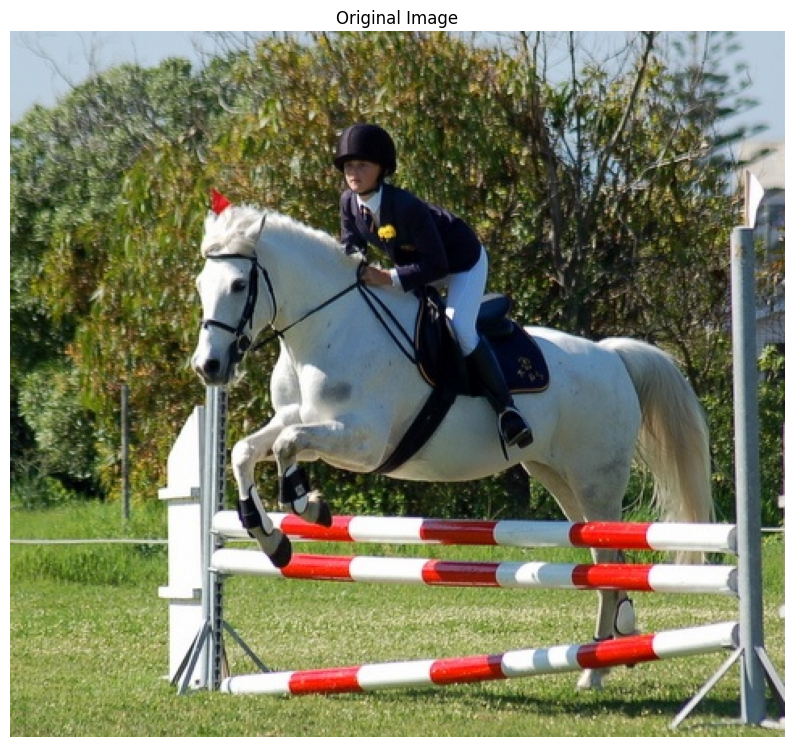

Found 2 ground truth annotations
Raw predictions: 0 boxes detected

All predictions (top 10):

After filtering (threshold=0.01): 0 boxes


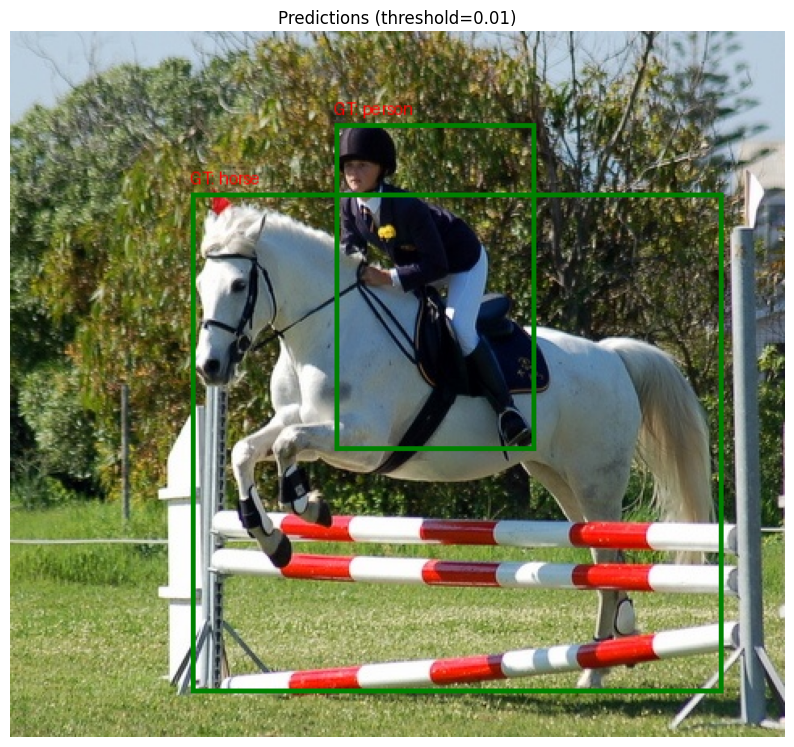

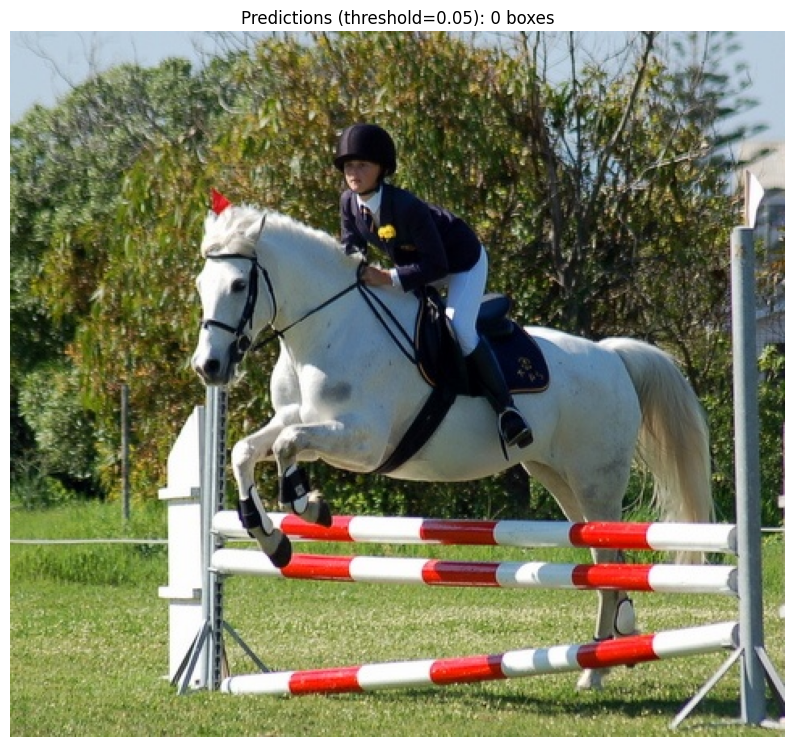

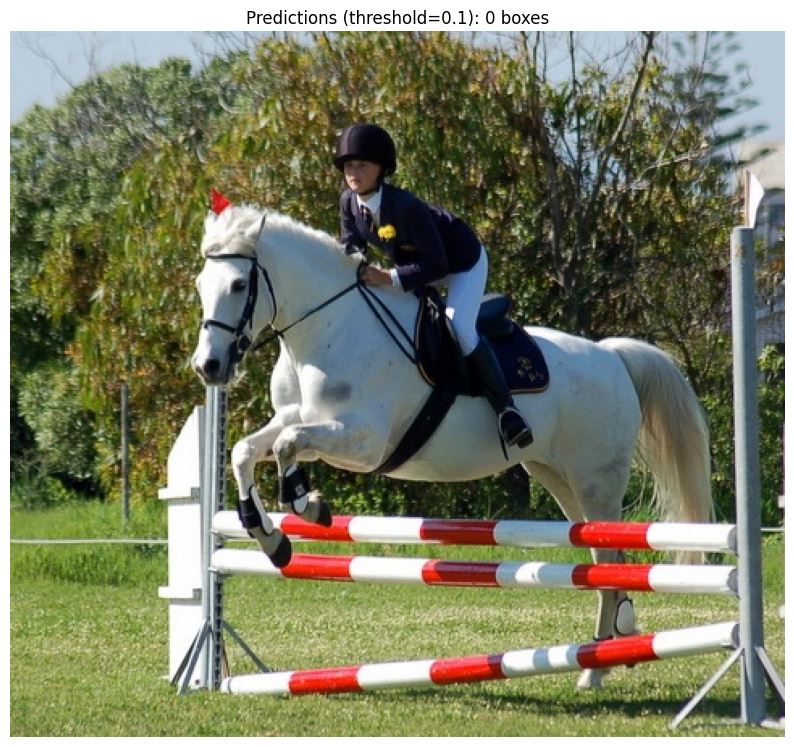

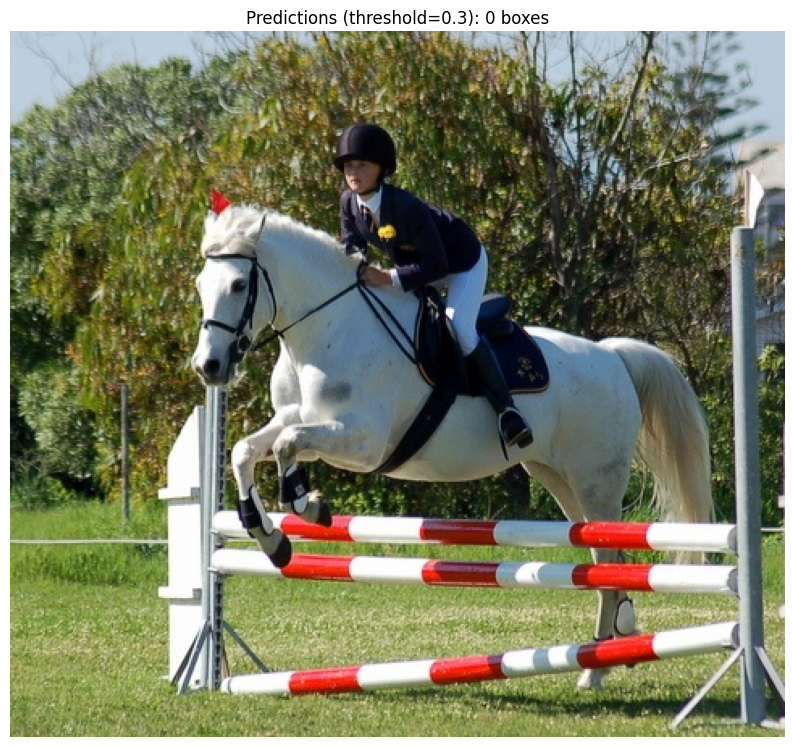


Model inspection:
Number of classes: 21
Score threshold: 0.05
NMS threshold: 0.5
Detections per image: 100

RoI Box Predictor:
FastRCNNPredictor(
  (cls_score): Linear(in_features=1024, out_features=21, bias=True)
  (bbox_pred): Linear(in_features=1024, out_features=84, bias=True)
)


In [33]:
import torch
import torchvision
import torchvision.transforms.functional as F
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import json
import numpy as np
import os

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load category information from COCO annotations
try:
    with open("/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_test.json", 'r') as f:
        coco_data = json.load(f)
    
    # Create category ID to name mapping
    categories = {cat['id']: cat['name'] for cat in coco_data['categories']}
    print(f"Categories: {categories}")
except Exception as e:
    print(f"Error loading categories: {e}")
    # Fallback to generic labels
    categories = {i: f"Class {i}" for i in range(1, 21)}

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except Exception as e:
    print(f"❌ Error loading model: {e}")

model.to(device)
model.eval()

# Function to process a single image
def process_single_image(image_path, confidence_threshold=0.5):
    print(f"Processing image: {image_path}")
    
    # Load image
    image = Image.open(image_path).convert("RGB")
    
    # Display original image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")
    plt.show()
    
    # Get ground truth annotations (if available)
    image_id = os.path.basename(image_path).split('.')[0]  # Assuming filename is the image_id
    gt_boxes = []
    gt_labels = []
    
    try:
        # Find annotations for this image
        image_info = next((img for img in coco_data['images'] if img['file_name'].endswith(f"{image_id}.jpg")), None)
        if image_info:
            image_id_int = image_info['id']
            annotations = [ann for ann in coco_data['annotations'] if ann['image_id'] == image_id_int]
            
            for ann in annotations:
                x, y, w, h = ann['bbox']
                gt_boxes.append([x, y, x+w, y+h])
                gt_labels.append(ann['category_id'])
            
            print(f"Found {len(annotations)} ground truth annotations")
    except Exception as e:
        print(f"Could not load ground truth annotations: {e}")
    
    # Apply transformations
    transform = torchvision.transforms.ToTensor()
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    # Run inference
    with torch.no_grad():
        prediction = model(image_tensor)[0]
    
    # Print prediction stats
    pred_boxes = prediction['boxes'].cpu().numpy()
    pred_scores = prediction['scores'].cpu().numpy()
    pred_labels = prediction['labels'].cpu().numpy()
    
    print(f"Raw predictions: {len(pred_boxes)} boxes detected")
    
    # Show all predictions regardless of confidence
    print("\nAll predictions (top 10):")
    for i in range(min(10, len(pred_boxes))):
        label_id = pred_labels[i]
        label_name = categories.get(label_id, f"Class {label_id}")
        print(f"Box {i+1}: {label_name} (ID: {label_id}) - Score: {pred_scores[i]:.4f} - Coords: {pred_boxes[i]}")
    
    # Filter by confidence threshold
    filtered_indices = np.where(pred_scores >= confidence_threshold)[0]
    filtered_boxes = pred_boxes[filtered_indices]
    filtered_scores = pred_scores[filtered_indices]
    filtered_labels = pred_labels[filtered_indices]
    
    print(f"\nAfter filtering (threshold={confidence_threshold}): {len(filtered_boxes)} boxes")
    
    # Create a PIL image for drawing boxes
    result_img = image.copy()
    draw = ImageDraw.Draw(result_img)
    
    # Draw ground truth boxes in green
    for box, label in zip(gt_boxes, gt_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="green", width=3)
        draw.text((x_min, y_min-15), f"GT: {label_name}", fill="red")
    
    # Draw predicted boxes in red
    for box, score, label in zip(filtered_boxes, filtered_scores, filtered_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
        draw.text((x_min, y_min-15), f"Pred: {label_name} ({score:.2f})", fill="red")
    
    # Show the result
    plt.figure(figsize=(10, 10))
    plt.imshow(result_img)
    plt.title(f"Predictions (threshold={confidence_threshold})")
    plt.axis("off")
    plt.show()
    
    # Try multiple thresholds
    for threshold in [0.05, 0.1, 0.3]:
        if threshold == confidence_threshold:
            continue
            
        indices = np.where(pred_scores >= threshold)[0]
        boxes = pred_boxes[indices]
        scores = pred_scores[indices]
        labels = pred_labels[indices]
        
        # Create a new image for this threshold
        threshold_img = image.copy()
        draw = ImageDraw.Draw(threshold_img)
        
        # Draw boxes
        for box, score, label in zip(boxes, scores, labels):
            x_min, y_min, x_max, y_max = box
            label_name = categories.get(label, f"Class {label}")
            draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
            draw.text((x_min, y_min-15), f"{label_name} ({score:.2f})", fill="red")
        
        # Show the result
        plt.figure(figsize=(10, 10))
        plt.imshow(threshold_img)
        plt.title(f"Predictions (threshold={threshold}): {len(boxes)} boxes")
        plt.axis("off")
        plt.show()
    
    return prediction

# Image path - replace with your actual test image path
image_path = "/kaggle/input/g2-project/output_dataset/images/test/2007_000783.jpg"

# Process the image with a low threshold to see all potential detections
results = process_single_image(image_path, confidence_threshold=0.01)

# Additional model inspection
print("\nModel inspection:")
print(f"Number of classes: {num_classes}")
print(f"Score threshold: {model.roi_heads.score_thresh}")
print(f"NMS threshold: {model.roi_heads.nms_thresh}")
print(f"Detections per image: {model.roi_heads.detections_per_img}")

# Check the box predictor and classifier
print("\nRoI Box Predictor:")
print(model.roi_heads.box_predictor)

Using device: cuda
Categories: {1: 'tvmonitor', 2: 'car', 3: 'dog', 4: 'person', 5: 'cow', 6: 'sofa', 7: 'sheep', 8: 'train', 9: 'aeroplane', 10: 'bottle', 11: 'cat', 12: 'bird', 13: 'diningtable', 14: 'chair', 15: 'motorbike', 16: 'horse', 17: 'pottedplant', 18: 'bus', 19: 'boat', 20: 'bicycle'}


<ipython-input-34-f16d23cef052>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth
Processing image: /kaggle/input/g2-project/output_dataset/images/test/2007_000799.jpg


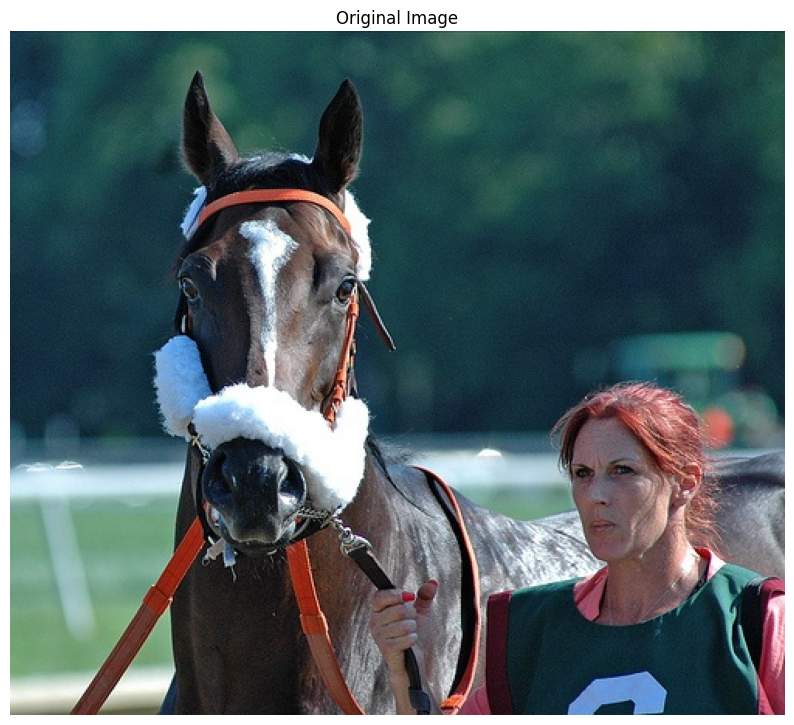

Found 2 ground truth annotations
Raw predictions: 0 boxes detected

All predictions (top 10):

After filtering (threshold=0.01): 0 boxes


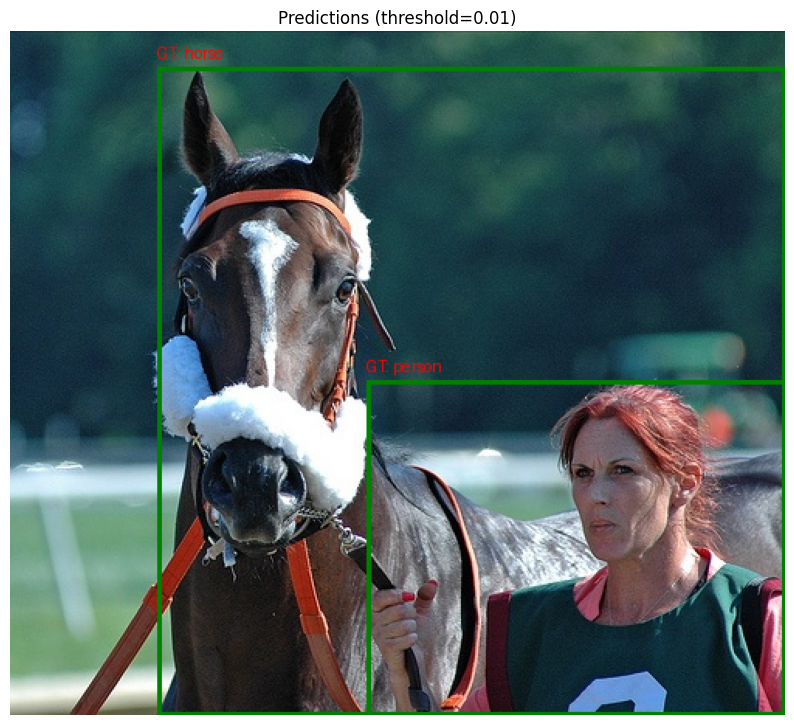

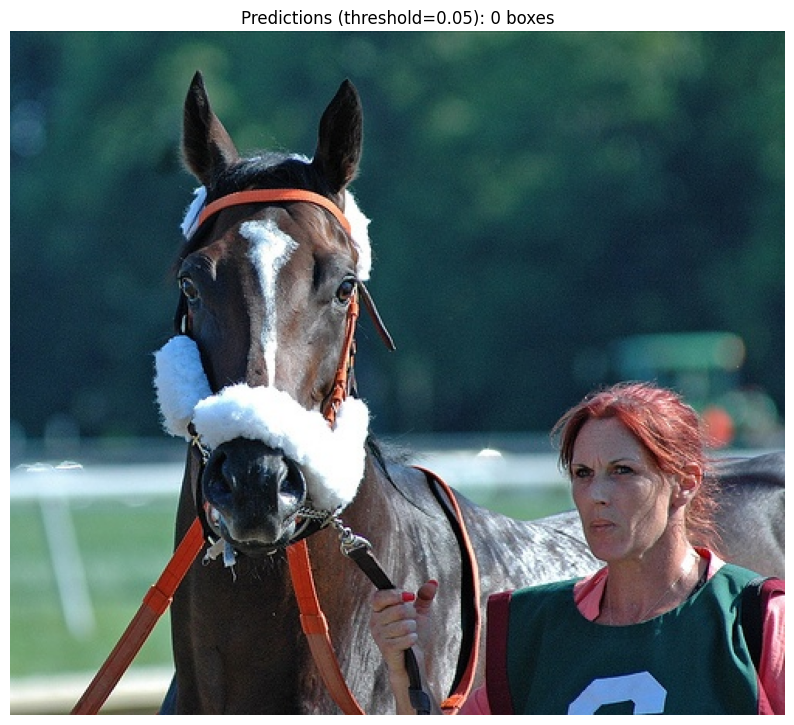

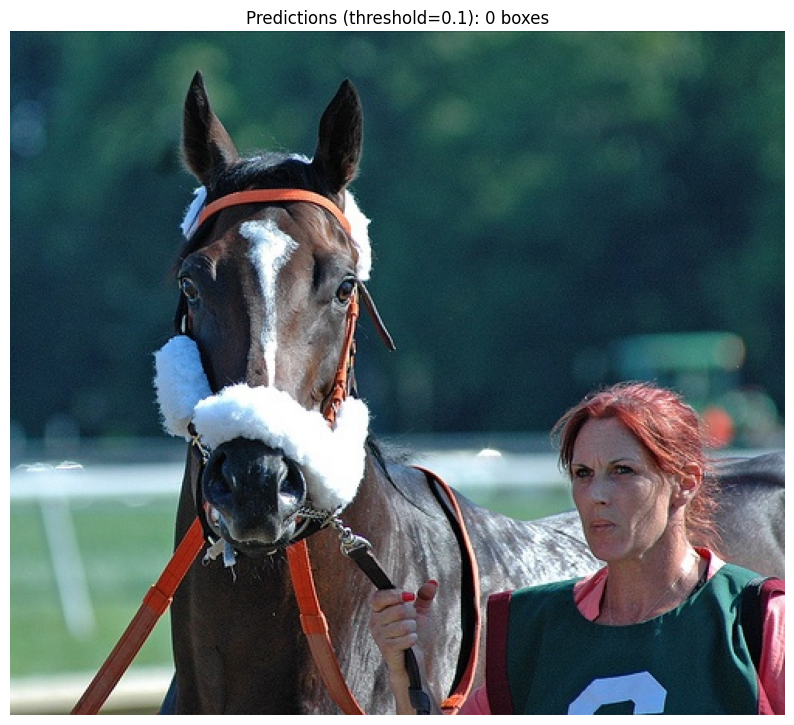

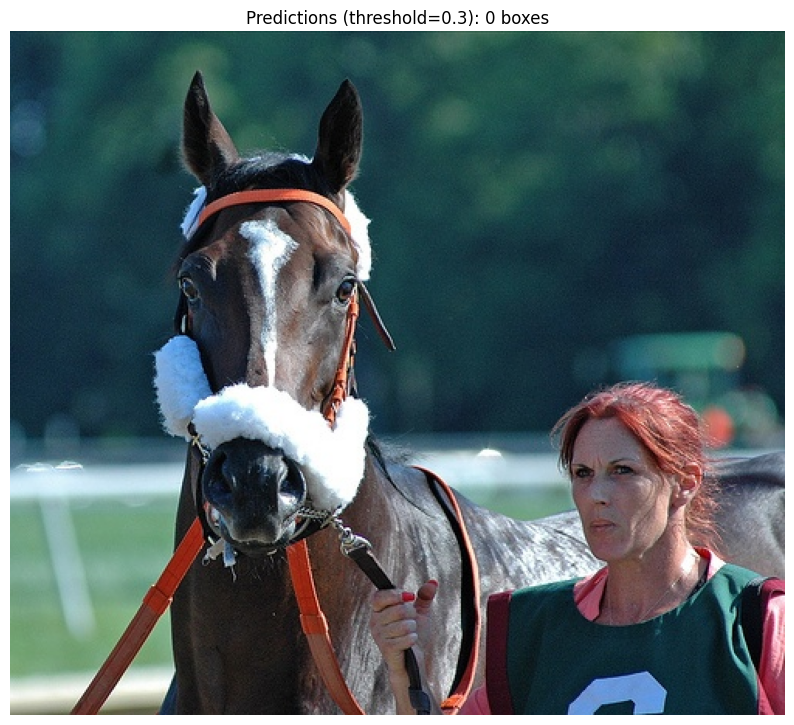


Model inspection:
Number of classes: 21
Score threshold: 0.05
NMS threshold: 0.5
Detections per image: 100

RoI Box Predictor:
FastRCNNPredictor(
  (cls_score): Linear(in_features=1024, out_features=21, bias=True)
  (bbox_pred): Linear(in_features=1024, out_features=84, bias=True)
)


In [34]:
import torch
import torchvision
import torchvision.transforms.functional as F
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import json
import numpy as np
import os

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load category information from COCO annotations
try:
    with open("/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_test.json", 'r') as f:
        coco_data = json.load(f)
    
    # Create category ID to name mapping
    categories = {cat['id']: cat['name'] for cat in coco_data['categories']}
    print(f"Categories: {categories}")
except Exception as e:
    print(f"Error loading categories: {e}")
    # Fallback to generic labels
    categories = {i: f"Class {i}" for i in range(1, 21)}

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except Exception as e:
    print(f"❌ Error loading model: {e}")

model.to(device)
model.eval()

# Function to process a single image
def process_single_image(image_path, confidence_threshold=0.5):
    print(f"Processing image: {image_path}")
    
    # Load image
    image = Image.open(image_path).convert("RGB")
    
    # Display original image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")
    plt.show()
    
    # Get ground truth annotations (if available)
    image_id = os.path.basename(image_path).split('.')[0]  # Assuming filename is the image_id
    gt_boxes = []
    gt_labels = []
    
    try:
        # Find annotations for this image
        image_info = next((img for img in coco_data['images'] if img['file_name'].endswith(f"{image_id}.jpg")), None)
        if image_info:
            image_id_int = image_info['id']
            annotations = [ann for ann in coco_data['annotations'] if ann['image_id'] == image_id_int]
            
            for ann in annotations:
                x, y, w, h = ann['bbox']
                gt_boxes.append([x, y, x+w, y+h])
                gt_labels.append(ann['category_id'])
            
            print(f"Found {len(annotations)} ground truth annotations")
    except Exception as e:
        print(f"Could not load ground truth annotations: {e}")
    
    # Apply transformations
    transform = torchvision.transforms.ToTensor()
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    # Run inference
    with torch.no_grad():
        prediction = model(image_tensor)[0]
    
    # Print prediction stats
    pred_boxes = prediction['boxes'].cpu().numpy()
    pred_scores = prediction['scores'].cpu().numpy()
    pred_labels = prediction['labels'].cpu().numpy()
    
    print(f"Raw predictions: {len(pred_boxes)} boxes detected")
    
    # Show all predictions regardless of confidence
    print("\nAll predictions (top 10):")
    for i in range(min(10, len(pred_boxes))):
        label_id = pred_labels[i]
        label_name = categories.get(label_id, f"Class {label_id}")
        print(f"Box {i+1}: {label_name} (ID: {label_id}) - Score: {pred_scores[i]:.4f} - Coords: {pred_boxes[i]}")
    
    # Filter by confidence threshold
    filtered_indices = np.where(pred_scores >= confidence_threshold)[0]
    filtered_boxes = pred_boxes[filtered_indices]
    filtered_scores = pred_scores[filtered_indices]
    filtered_labels = pred_labels[filtered_indices]
    
    print(f"\nAfter filtering (threshold={confidence_threshold}): {len(filtered_boxes)} boxes")
    
    # Create a PIL image for drawing boxes
    result_img = image.copy()
    draw = ImageDraw.Draw(result_img)
    
    # Draw ground truth boxes in green
    for box, label in zip(gt_boxes, gt_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="green", width=3)
        draw.text((x_min, y_min-15), f"GT: {label_name}", fill="red")
    
    # Draw predicted boxes in red
    for box, score, label in zip(filtered_boxes, filtered_scores, filtered_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
        draw.text((x_min, y_min-15), f"Pred: {label_name} ({score:.2f})", fill="red")
    
    # Show the result
    plt.figure(figsize=(10, 10))
    plt.imshow(result_img)
    plt.title(f"Predictions (threshold={confidence_threshold})")
    plt.axis("off")
    plt.show()
    
    # Try multiple thresholds
    for threshold in [0.05, 0.1, 0.3]:
        if threshold == confidence_threshold:
            continue
            
        indices = np.where(pred_scores >= threshold)[0]
        boxes = pred_boxes[indices]
        scores = pred_scores[indices]
        labels = pred_labels[indices]
        
        # Create a new image for this threshold
        threshold_img = image.copy()
        draw = ImageDraw.Draw(threshold_img)
        
        # Draw boxes
        for box, score, label in zip(boxes, scores, labels):
            x_min, y_min, x_max, y_max = box
            label_name = categories.get(label, f"Class {label}")
            draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
            draw.text((x_min, y_min-15), f"{label_name} ({score:.2f})", fill="red")
        
        # Show the result
        plt.figure(figsize=(10, 10))
        plt.imshow(threshold_img)
        plt.title(f"Predictions (threshold={threshold}): {len(boxes)} boxes")
        plt.axis("off")
        plt.show()
    
    return prediction

# Image path - replace with your actual test image path
image_path = "/kaggle/input/g2-project/output_dataset/images/test/2007_000799.jpg"

# Process the image with a low threshold to see all potential detections
results = process_single_image(image_path, confidence_threshold=0.01)

# Additional model inspection
print("\nModel inspection:")
print(f"Number of classes: {num_classes}")
print(f"Score threshold: {model.roi_heads.score_thresh}")
print(f"NMS threshold: {model.roi_heads.nms_thresh}")
print(f"Detections per image: {model.roi_heads.detections_per_img}")

# Check the box predictor and classifier
print("\nRoI Box Predictor:")
print(model.roi_heads.box_predictor)

Using device: cuda
Categories: {1: 'tvmonitor', 2: 'car', 3: 'dog', 4: 'person', 5: 'cow', 6: 'sofa', 7: 'sheep', 8: 'train', 9: 'aeroplane', 10: 'bottle', 11: 'cat', 12: 'bird', 13: 'diningtable', 14: 'chair', 15: 'motorbike', 16: 'horse', 17: 'pottedplant', 18: 'bus', 19: 'boat', 20: 'bicycle'}


<ipython-input-35-8613da659392>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth
Processing image: /kaggle/input/g2-project/output_dataset/images/test/2007_001154.jpg


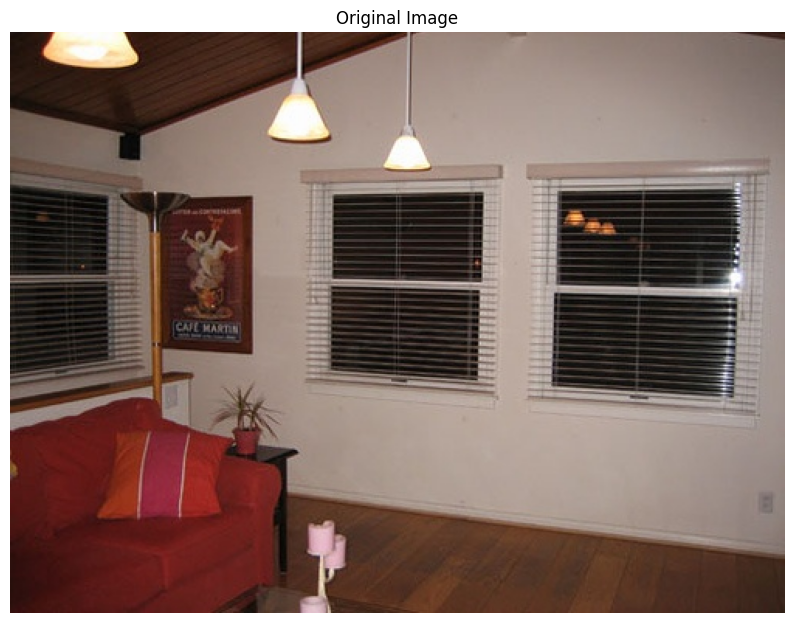

Found 2 ground truth annotations
Raw predictions: 0 boxes detected

All predictions (top 10):

After filtering (threshold=0.01): 0 boxes


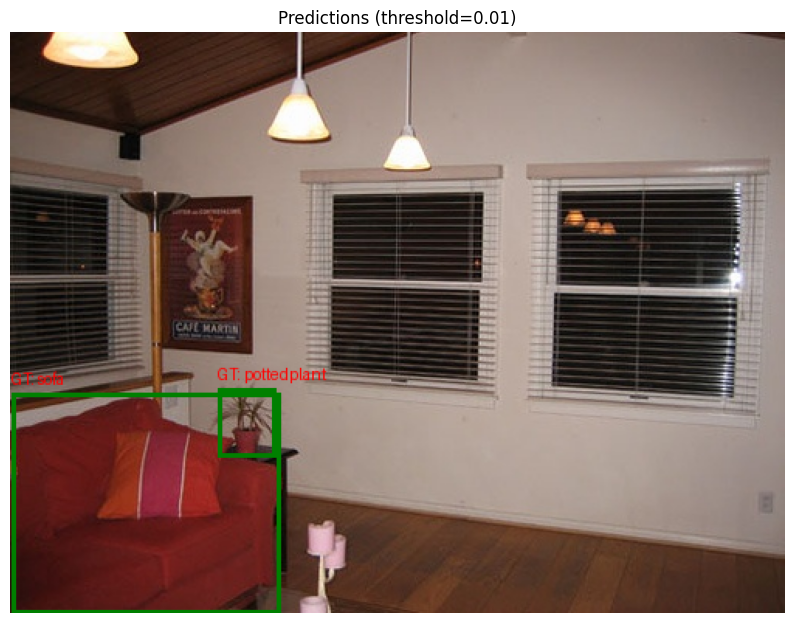

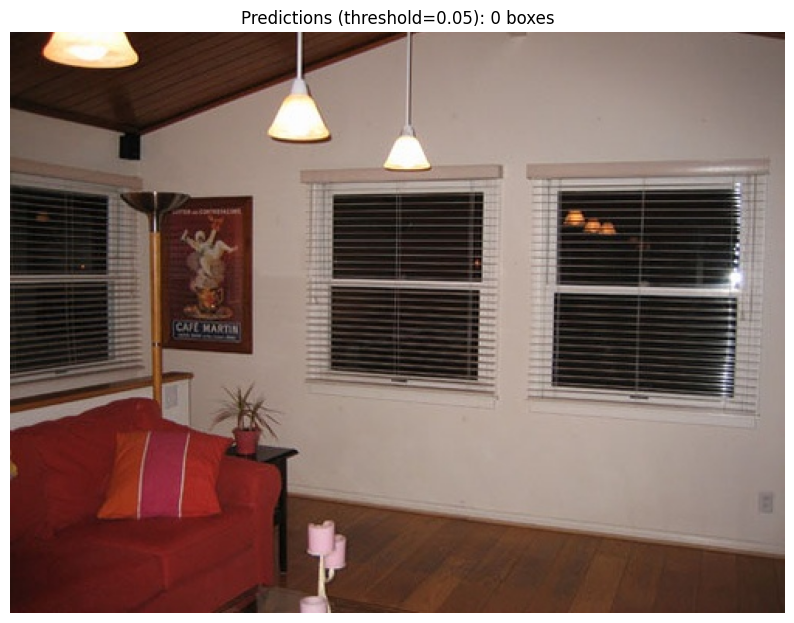

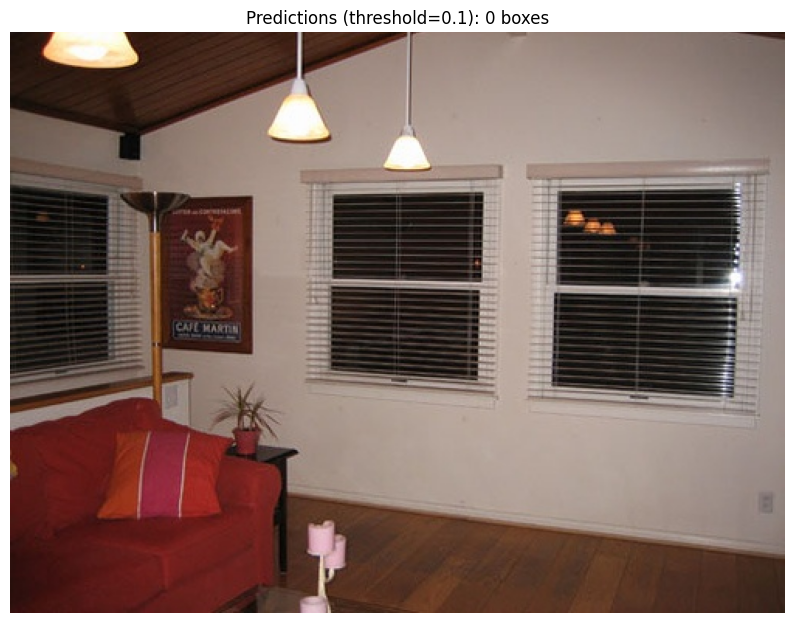

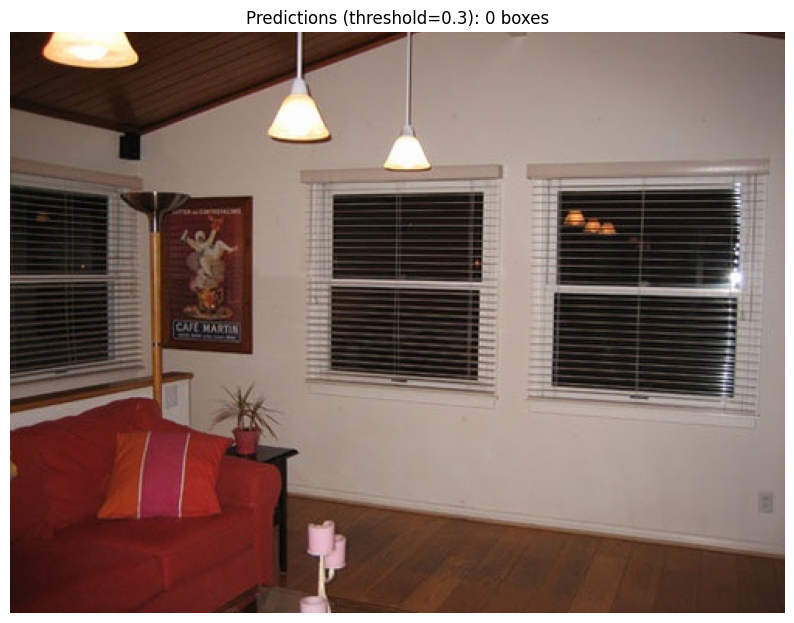


Model inspection:
Number of classes: 21
Score threshold: 0.05
NMS threshold: 0.5
Detections per image: 100

RoI Box Predictor:
FastRCNNPredictor(
  (cls_score): Linear(in_features=1024, out_features=21, bias=True)
  (bbox_pred): Linear(in_features=1024, out_features=84, bias=True)
)


In [35]:
import torch
import torchvision
import torchvision.transforms.functional as F
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import json
import numpy as np
import os

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load category information from COCO annotations
try:
    with open("/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_test.json", 'r') as f:
        coco_data = json.load(f)
    
    # Create category ID to name mapping
    categories = {cat['id']: cat['name'] for cat in coco_data['categories']}
    print(f"Categories: {categories}")
except Exception as e:
    print(f"Error loading categories: {e}")
    # Fallback to generic labels
    categories = {i: f"Class {i}" for i in range(1, 21)}

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except Exception as e:
    print(f"❌ Error loading model: {e}")

model.to(device)
model.eval()

# Function to process a single image
def process_single_image(image_path, confidence_threshold=0.5):
    print(f"Processing image: {image_path}")
    
    # Load image
    image = Image.open(image_path).convert("RGB")
    
    # Display original image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")
    plt.show()
    
    # Get ground truth annotations (if available)
    image_id = os.path.basename(image_path).split('.')[0]  # Assuming filename is the image_id
    gt_boxes = []
    gt_labels = []
    
    try:
        # Find annotations for this image
        image_info = next((img for img in coco_data['images'] if img['file_name'].endswith(f"{image_id}.jpg")), None)
        if image_info:
            image_id_int = image_info['id']
            annotations = [ann for ann in coco_data['annotations'] if ann['image_id'] == image_id_int]
            
            for ann in annotations:
                x, y, w, h = ann['bbox']
                gt_boxes.append([x, y, x+w, y+h])
                gt_labels.append(ann['category_id'])
            
            print(f"Found {len(annotations)} ground truth annotations")
    except Exception as e:
        print(f"Could not load ground truth annotations: {e}")
    
    # Apply transformations
    transform = torchvision.transforms.ToTensor()
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    # Run inference
    with torch.no_grad():
        prediction = model(image_tensor)[0]
    
    # Print prediction stats
    pred_boxes = prediction['boxes'].cpu().numpy()
    pred_scores = prediction['scores'].cpu().numpy()
    pred_labels = prediction['labels'].cpu().numpy()
    
    print(f"Raw predictions: {len(pred_boxes)} boxes detected")
    
    # Show all predictions regardless of confidence
    print("\nAll predictions (top 10):")
    for i in range(min(10, len(pred_boxes))):
        label_id = pred_labels[i]
        label_name = categories.get(label_id, f"Class {label_id}")
        print(f"Box {i+1}: {label_name} (ID: {label_id}) - Score: {pred_scores[i]:.4f} - Coords: {pred_boxes[i]}")
    
    # Filter by confidence threshold
    filtered_indices = np.where(pred_scores >= confidence_threshold)[0]
    filtered_boxes = pred_boxes[filtered_indices]
    filtered_scores = pred_scores[filtered_indices]
    filtered_labels = pred_labels[filtered_indices]
    
    print(f"\nAfter filtering (threshold={confidence_threshold}): {len(filtered_boxes)} boxes")
    
    # Create a PIL image for drawing boxes
    result_img = image.copy()
    draw = ImageDraw.Draw(result_img)
    
    # Draw ground truth boxes in green
    for box, label in zip(gt_boxes, gt_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="green", width=3)
        draw.text((x_min, y_min-15), f"GT: {label_name}", fill="red")
    
    # Draw predicted boxes in red
    for box, score, label in zip(filtered_boxes, filtered_scores, filtered_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
        draw.text((x_min, y_min-15), f"Pred: {label_name} ({score:.2f})", fill="red")
    
    # Show the result
    plt.figure(figsize=(10, 10))
    plt.imshow(result_img)
    plt.title(f"Predictions (threshold={confidence_threshold})")
    plt.axis("off")
    plt.show()
    
    # Try multiple thresholds
    for threshold in [0.05, 0.1, 0.3]:
        if threshold == confidence_threshold:
            continue
            
        indices = np.where(pred_scores >= threshold)[0]
        boxes = pred_boxes[indices]
        scores = pred_scores[indices]
        labels = pred_labels[indices]
        
        # Create a new image for this threshold
        threshold_img = image.copy()
        draw = ImageDraw.Draw(threshold_img)
        
        # Draw boxes
        for box, score, label in zip(boxes, scores, labels):
            x_min, y_min, x_max, y_max = box
            label_name = categories.get(label, f"Class {label}")
            draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
            draw.text((x_min, y_min-15), f"{label_name} ({score:.2f})", fill="red")
        
        # Show the result
        plt.figure(figsize=(10, 10))
        plt.imshow(threshold_img)
        plt.title(f"Predictions (threshold={threshold}): {len(boxes)} boxes")
        plt.axis("off")
        plt.show()
    
    return prediction

# Image path - replace with your actual test image path
image_path = "/kaggle/input/g2-project/output_dataset/images/test/2007_001154.jpg"

# Process the image with a low threshold to see all potential detections
results = process_single_image(image_path, confidence_threshold=0.01)

# Additional model inspection
print("\nModel inspection:")
print(f"Number of classes: {num_classes}")
print(f"Score threshold: {model.roi_heads.score_thresh}")
print(f"NMS threshold: {model.roi_heads.nms_thresh}")
print(f"Detections per image: {model.roi_heads.detections_per_img}")

# Check the box predictor and classifier
print("\nRoI Box Predictor:")
print(model.roi_heads.box_predictor)

Using device: cuda
Categories: {1: 'tvmonitor', 2: 'car', 3: 'dog', 4: 'person', 5: 'cow', 6: 'sofa', 7: 'sheep', 8: 'train', 9: 'aeroplane', 10: 'bottle', 11: 'cat', 12: 'bird', 13: 'diningtable', 14: 'chair', 15: 'motorbike', 16: 'horse', 17: 'pottedplant', 18: 'bus', 19: 'boat', 20: 'bicycle'}


<ipython-input-36-0046f866aae7>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth
Processing image: /kaggle/input/g2-project/output_dataset/images/test/2007_002387.jpg


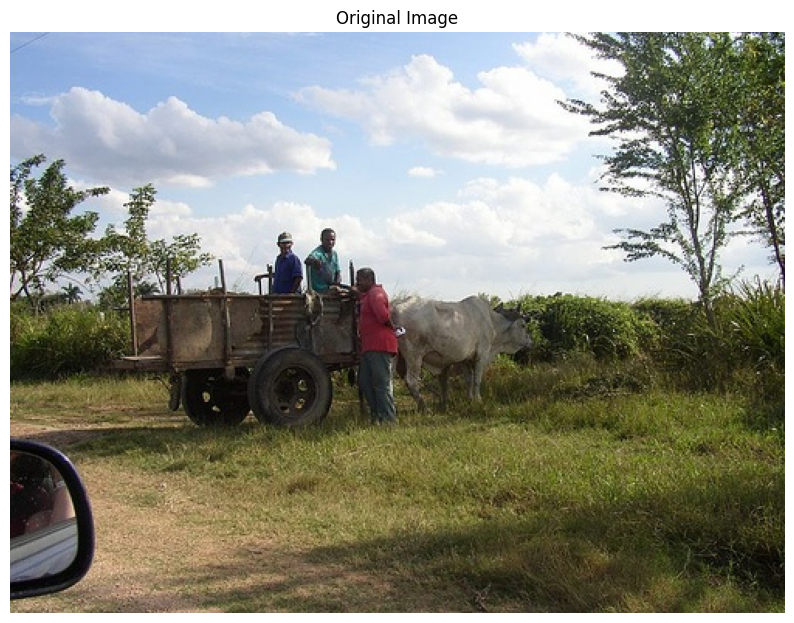

Found 4 ground truth annotations
Raw predictions: 0 boxes detected

All predictions (top 10):

After filtering (threshold=0.01): 0 boxes


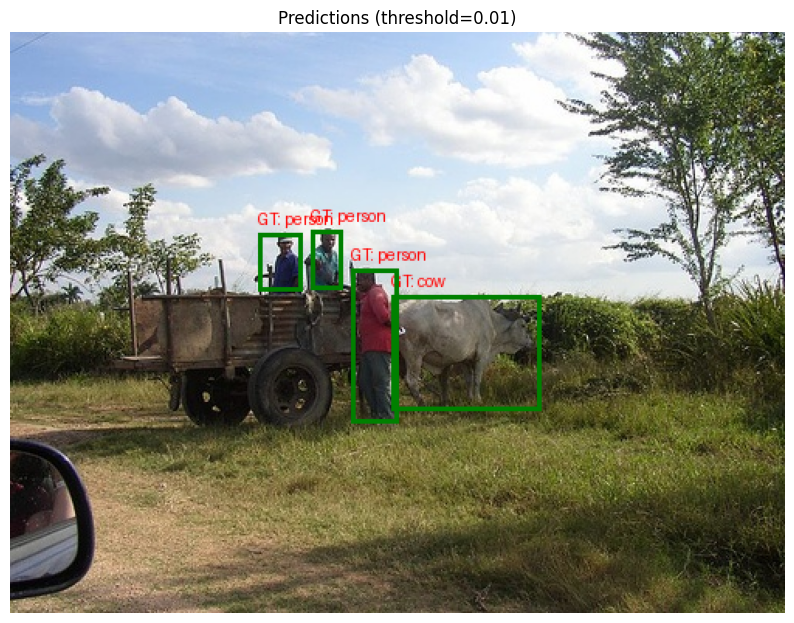

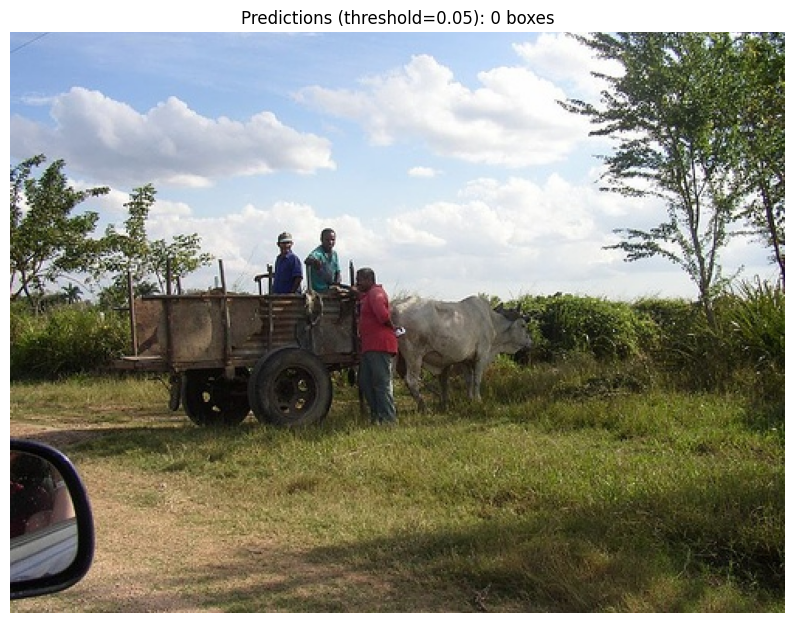

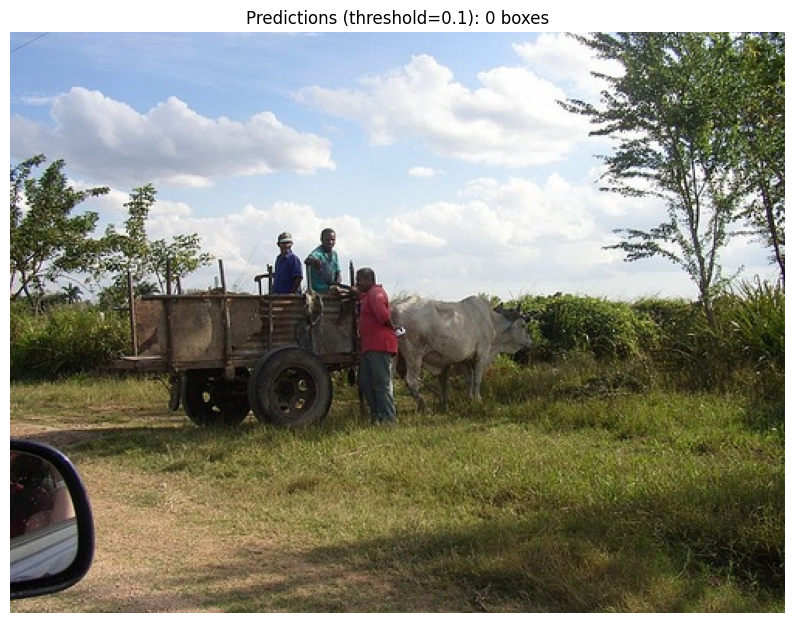

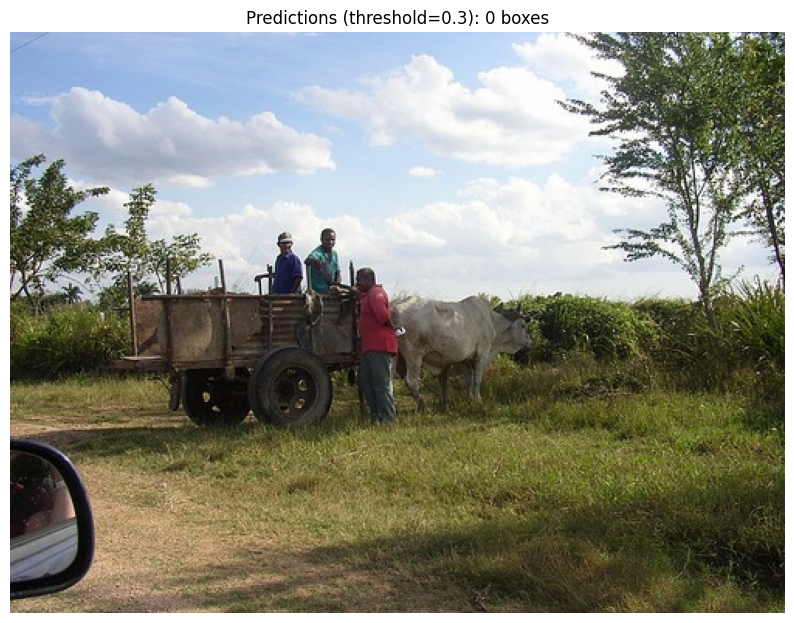


Model inspection:
Number of classes: 21
Score threshold: 0.05
NMS threshold: 0.5
Detections per image: 100

RoI Box Predictor:
FastRCNNPredictor(
  (cls_score): Linear(in_features=1024, out_features=21, bias=True)
  (bbox_pred): Linear(in_features=1024, out_features=84, bias=True)
)


In [36]:
import torch
import torchvision
import torchvision.transforms.functional as F
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import json
import numpy as np
import os

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load category information from COCO annotations
try:
    with open("/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_test.json", 'r') as f:
        coco_data = json.load(f)
    
    # Create category ID to name mapping
    categories = {cat['id']: cat['name'] for cat in coco_data['categories']}
    print(f"Categories: {categories}")
except Exception as e:
    print(f"Error loading categories: {e}")
    # Fallback to generic labels
    categories = {i: f"Class {i}" for i in range(1, 21)}

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except Exception as e:
    print(f"❌ Error loading model: {e}")

model.to(device)
model.eval()

# Function to process a single image
def process_single_image(image_path, confidence_threshold=0.5):
    print(f"Processing image: {image_path}")
    
    # Load image
    image = Image.open(image_path).convert("RGB")
    
    # Display original image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")
    plt.show()
    
    # Get ground truth annotations (if available)
    image_id = os.path.basename(image_path).split('.')[0]  # Assuming filename is the image_id
    gt_boxes = []
    gt_labels = []
    
    try:
        # Find annotations for this image
        image_info = next((img for img in coco_data['images'] if img['file_name'].endswith(f"{image_id}.jpg")), None)
        if image_info:
            image_id_int = image_info['id']
            annotations = [ann for ann in coco_data['annotations'] if ann['image_id'] == image_id_int]
            
            for ann in annotations:
                x, y, w, h = ann['bbox']
                gt_boxes.append([x, y, x+w, y+h])
                gt_labels.append(ann['category_id'])
            
            print(f"Found {len(annotations)} ground truth annotations")
    except Exception as e:
        print(f"Could not load ground truth annotations: {e}")
    
    # Apply transformations
    transform = torchvision.transforms.ToTensor()
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    # Run inference
    with torch.no_grad():
        prediction = model(image_tensor)[0]
    
    # Print prediction stats
    pred_boxes = prediction['boxes'].cpu().numpy()
    pred_scores = prediction['scores'].cpu().numpy()
    pred_labels = prediction['labels'].cpu().numpy()
    
    print(f"Raw predictions: {len(pred_boxes)} boxes detected")
    
    # Show all predictions regardless of confidence
    print("\nAll predictions (top 10):")
    for i in range(min(10, len(pred_boxes))):
        label_id = pred_labels[i]
        label_name = categories.get(label_id, f"Class {label_id}")
        print(f"Box {i+1}: {label_name} (ID: {label_id}) - Score: {pred_scores[i]:.4f} - Coords: {pred_boxes[i]}")
    
    # Filter by confidence threshold
    filtered_indices = np.where(pred_scores >= confidence_threshold)[0]
    filtered_boxes = pred_boxes[filtered_indices]
    filtered_scores = pred_scores[filtered_indices]
    filtered_labels = pred_labels[filtered_indices]
    
    print(f"\nAfter filtering (threshold={confidence_threshold}): {len(filtered_boxes)} boxes")
    
    # Create a PIL image for drawing boxes
    result_img = image.copy()
    draw = ImageDraw.Draw(result_img)
    
    # Draw ground truth boxes in green
    for box, label in zip(gt_boxes, gt_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="green", width=3)
        draw.text((x_min, y_min-15), f"GT: {label_name}", fill="red")
    
    # Draw predicted boxes in red
    for box, score, label in zip(filtered_boxes, filtered_scores, filtered_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
        draw.text((x_min, y_min-15), f"Pred: {label_name} ({score:.2f})", fill="red")
    
    # Show the result
    plt.figure(figsize=(10, 10))
    plt.imshow(result_img)
    plt.title(f"Predictions (threshold={confidence_threshold})")
    plt.axis("off")
    plt.show()
    
    # Try multiple thresholds
    for threshold in [0.05, 0.1, 0.3]:
        if threshold == confidence_threshold:
            continue
            
        indices = np.where(pred_scores >= threshold)[0]
        boxes = pred_boxes[indices]
        scores = pred_scores[indices]
        labels = pred_labels[indices]
        
        # Create a new image for this threshold
        threshold_img = image.copy()
        draw = ImageDraw.Draw(threshold_img)
        
        # Draw boxes
        for box, score, label in zip(boxes, scores, labels):
            x_min, y_min, x_max, y_max = box
            label_name = categories.get(label, f"Class {label}")
            draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
            draw.text((x_min, y_min-15), f"{label_name} ({score:.2f})", fill="red")
        
        # Show the result
        plt.figure(figsize=(10, 10))
        plt.imshow(threshold_img)
        plt.title(f"Predictions (threshold={threshold}): {len(boxes)} boxes")
        plt.axis("off")
        plt.show()
    
    return prediction

# Image path - replace with your actual test image path
image_path = "/kaggle/input/g2-project/output_dataset/images/test/2007_002387.jpg"

# Process the image with a low threshold to see all potential detections
results = process_single_image(image_path, confidence_threshold=0.01)

# Additional model inspection
print("\nModel inspection:")
print(f"Number of classes: {num_classes}")
print(f"Score threshold: {model.roi_heads.score_thresh}")
print(f"NMS threshold: {model.roi_heads.nms_thresh}")
print(f"Detections per image: {model.roi_heads.detections_per_img}")

# Check the box predictor and classifier
print("\nRoI Box Predictor:")
print(model.roi_heads.box_predictor)

Using device: cuda
Categories: {1: 'tvmonitor', 2: 'car', 3: 'dog', 4: 'person', 5: 'cow', 6: 'sofa', 7: 'sheep', 8: 'train', 9: 'aeroplane', 10: 'bottle', 11: 'cat', 12: 'bird', 13: 'diningtable', 14: 'chair', 15: 'motorbike', 16: 'horse', 17: 'pottedplant', 18: 'bus', 19: 'boat', 20: 'bicycle'}


<ipython-input-38-0c3259186eb9>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth
Processing image: /kaggle/input/g2-project/output_dataset/images/test/2007_000793.jpg


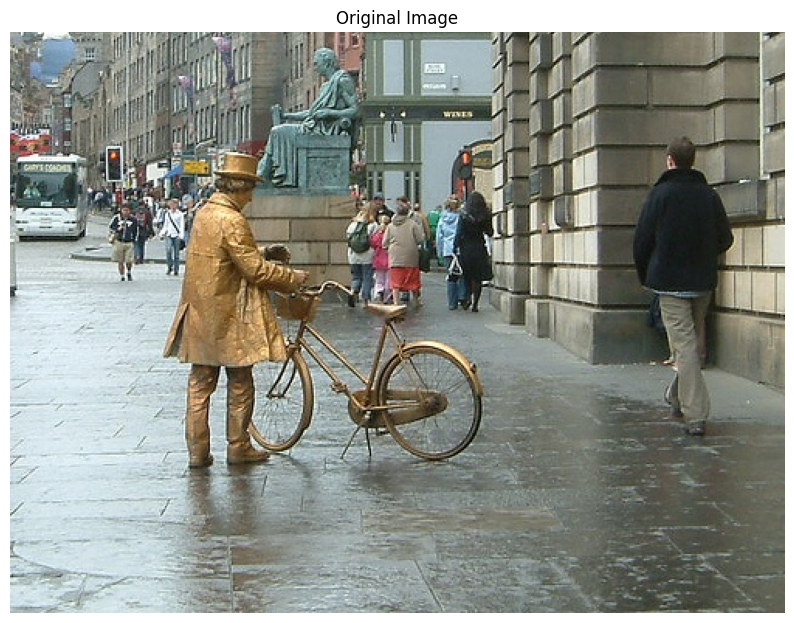

Found 10 ground truth annotations
Raw predictions: 0 boxes detected

All predictions (top 10):

After filtering (threshold=0.01): 0 boxes


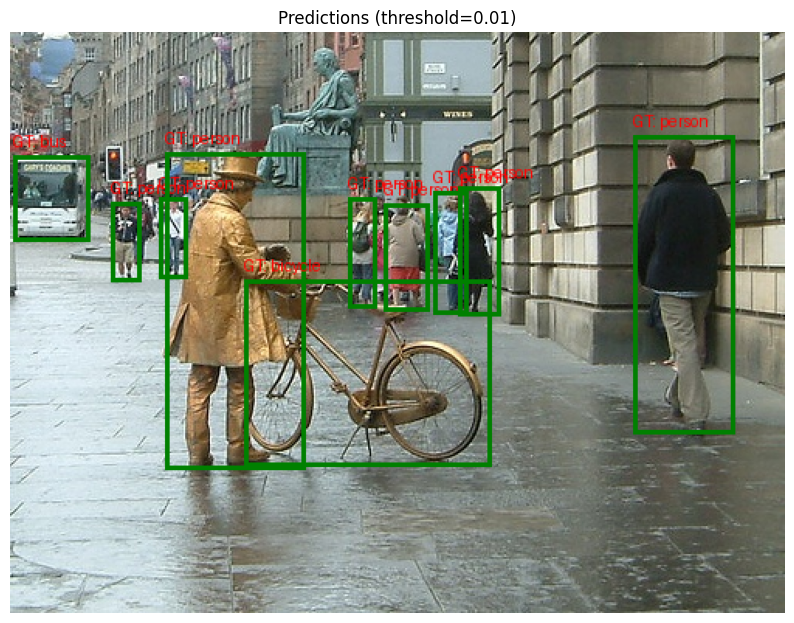

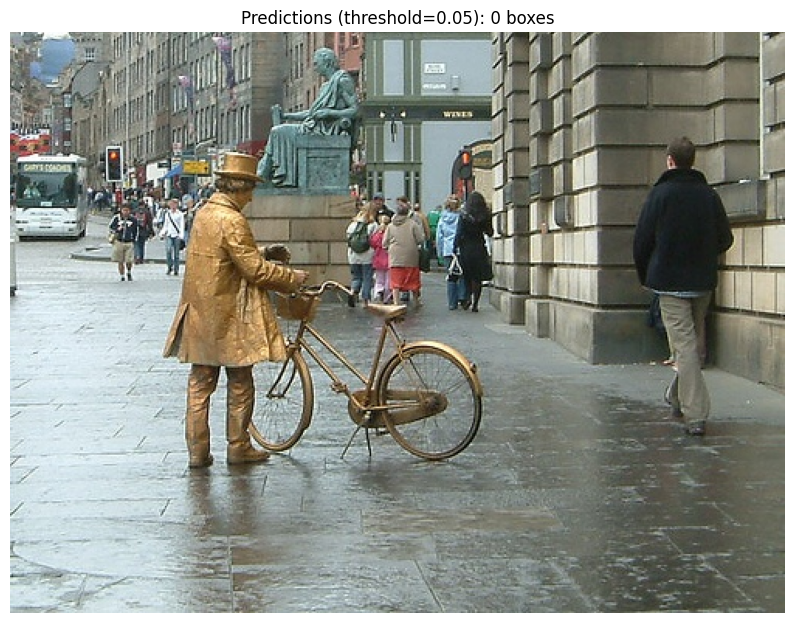

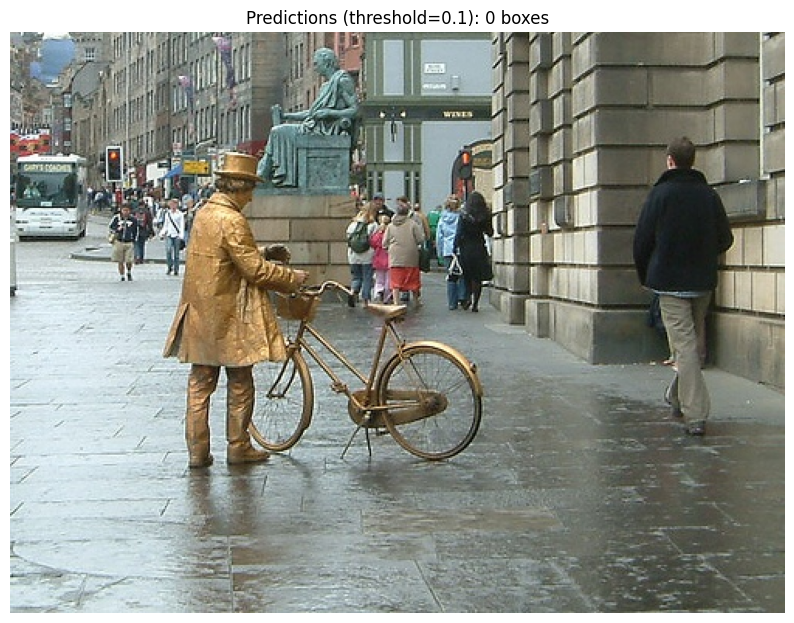

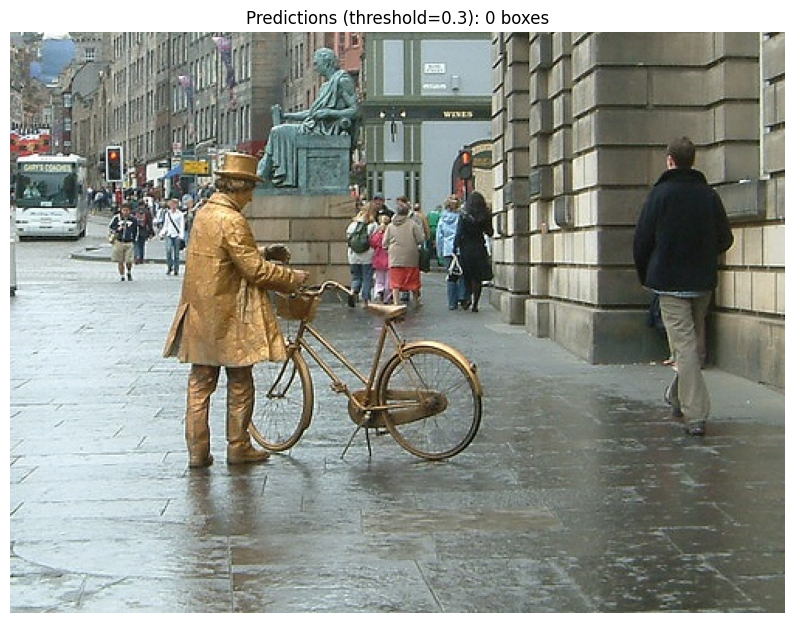


Model inspection:
Number of classes: 21
Score threshold: 0.05
NMS threshold: 0.5
Detections per image: 100

RoI Box Predictor:
FastRCNNPredictor(
  (cls_score): Linear(in_features=1024, out_features=21, bias=True)
  (bbox_pred): Linear(in_features=1024, out_features=84, bias=True)
)


In [38]:
import torch
import torchvision
import torchvision.transforms.functional as F
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import json
import numpy as np
import os

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load category information from COCO annotations
try:
    with open("/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_test.json", 'r') as f:
        coco_data = json.load(f)
    
    # Create category ID to name mapping
    categories = {cat['id']: cat['name'] for cat in coco_data['categories']}
    print(f"Categories: {categories}")
except Exception as e:
    print(f"Error loading categories: {e}")
    # Fallback to generic labels
    categories = {i: f"Class {i}" for i in range(1, 21)}

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except Exception as e:
    print(f"❌ Error loading model: {e}")

model.to(device)
model.eval()

# Function to process a single image
def process_single_image(image_path, confidence_threshold=0.5):
    print(f"Processing image: {image_path}")
    
    # Load image
    image = Image.open(image_path).convert("RGB")
    
    # Display original image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")
    plt.show()
    
    # Get ground truth annotations (if available)
    image_id = os.path.basename(image_path).split('.')[0]  # Assuming filename is the image_id
    gt_boxes = []
    gt_labels = []
    
    try:
        # Find annotations for this image
        image_info = next((img for img in coco_data['images'] if img['file_name'].endswith(f"{image_id}.jpg")), None)
        if image_info:
            image_id_int = image_info['id']
            annotations = [ann for ann in coco_data['annotations'] if ann['image_id'] == image_id_int]
            
            for ann in annotations:
                x, y, w, h = ann['bbox']
                gt_boxes.append([x, y, x+w, y+h])
                gt_labels.append(ann['category_id'])
            
            print(f"Found {len(annotations)} ground truth annotations")
    except Exception as e:
        print(f"Could not load ground truth annotations: {e}")
    
    # Apply transformations
    transform = torchvision.transforms.ToTensor()
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    # Run inference
    with torch.no_grad():
        prediction = model(image_tensor)[0]
    
    # Print prediction stats
    pred_boxes = prediction['boxes'].cpu().numpy()
    pred_scores = prediction['scores'].cpu().numpy()
    pred_labels = prediction['labels'].cpu().numpy()
    
    print(f"Raw predictions: {len(pred_boxes)} boxes detected")
    
    # Show all predictions regardless of confidence
    print("\nAll predictions (top 10):")
    for i in range(min(10, len(pred_boxes))):
        label_id = pred_labels[i]
        label_name = categories.get(label_id, f"Class {label_id}")
        print(f"Box {i+1}: {label_name} (ID: {label_id}) - Score: {pred_scores[i]:.4f} - Coords: {pred_boxes[i]}")
    
    # Filter by confidence threshold
    filtered_indices = np.where(pred_scores >= confidence_threshold)[0]
    filtered_boxes = pred_boxes[filtered_indices]
    filtered_scores = pred_scores[filtered_indices]
    filtered_labels = pred_labels[filtered_indices]
    
    print(f"\nAfter filtering (threshold={confidence_threshold}): {len(filtered_boxes)} boxes")
    
    # Create a PIL image for drawing boxes
    result_img = image.copy()
    draw = ImageDraw.Draw(result_img)
    
    # Draw ground truth boxes in green
    for box, label in zip(gt_boxes, gt_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="green", width=3)
        draw.text((x_min, y_min-15), f"GT: {label_name}", fill="red")
    
    # Draw predicted boxes in red
    for box, score, label in zip(filtered_boxes, filtered_scores, filtered_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
        draw.text((x_min, y_min-15), f"Pred: {label_name} ({score:.2f})", fill="red")
    
    # Show the result
    plt.figure(figsize=(10, 10))
    plt.imshow(result_img)
    plt.title(f"Predictions (threshold={confidence_threshold})")
    plt.axis("off")
    plt.show()
    
    # Try multiple thresholds
    for threshold in [0.05, 0.1, 0.3]:
        if threshold == confidence_threshold:
            continue
            
        indices = np.where(pred_scores >= threshold)[0]
        boxes = pred_boxes[indices]
        scores = pred_scores[indices]
        labels = pred_labels[indices]
        
        # Create a new image for this threshold
        threshold_img = image.copy()
        draw = ImageDraw.Draw(threshold_img)
        
        # Draw boxes
        for box, score, label in zip(boxes, scores, labels):
            x_min, y_min, x_max, y_max = box
            label_name = categories.get(label, f"Class {label}")
            draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
            draw.text((x_min, y_min-15), f"{label_name} ({score:.2f})", fill="red")
        
        # Show the result
        plt.figure(figsize=(10, 10))
        plt.imshow(threshold_img)
        plt.title(f"Predictions (threshold={threshold}): {len(boxes)} boxes")
        plt.axis("off")
        plt.show()
    
    return prediction

# Image path - replace with your actual test image path
image_path = "/kaggle/input/g2-project/output_dataset/images/test/2007_000793.jpg"

# Process the image with a low threshold to see all potential detections
results = process_single_image(image_path, confidence_threshold=0.01)

# Additional model inspection
print("\nModel inspection:")
print(f"Number of classes: {num_classes}")
print(f"Score threshold: {model.roi_heads.score_thresh}")
print(f"NMS threshold: {model.roi_heads.nms_thresh}")
print(f"Detections per image: {model.roi_heads.detections_per_img}")

# Check the box predictor and classifier
print("\nRoI Box Predictor:")
print(model.roi_heads.box_predictor)

Using device: cuda
Categories: {1: 'tvmonitor', 2: 'car', 3: 'dog', 4: 'person', 5: 'cow', 6: 'sofa', 7: 'sheep', 8: 'train', 9: 'aeroplane', 10: 'bottle', 11: 'cat', 12: 'bird', 13: 'diningtable', 14: 'chair', 15: 'motorbike', 16: 'horse', 17: 'pottedplant', 18: 'bus', 19: 'boat', 20: 'bicycle'}


<ipython-input-39-a70fb0adc60e>:36: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(model_path, map_location=device))


✅ Model loaded successfully from /kaggle/working/fasterrcnn_best.pth
Processing image: /kaggle/input/g2-project/output_dataset/images/test/2007_000904.jpg


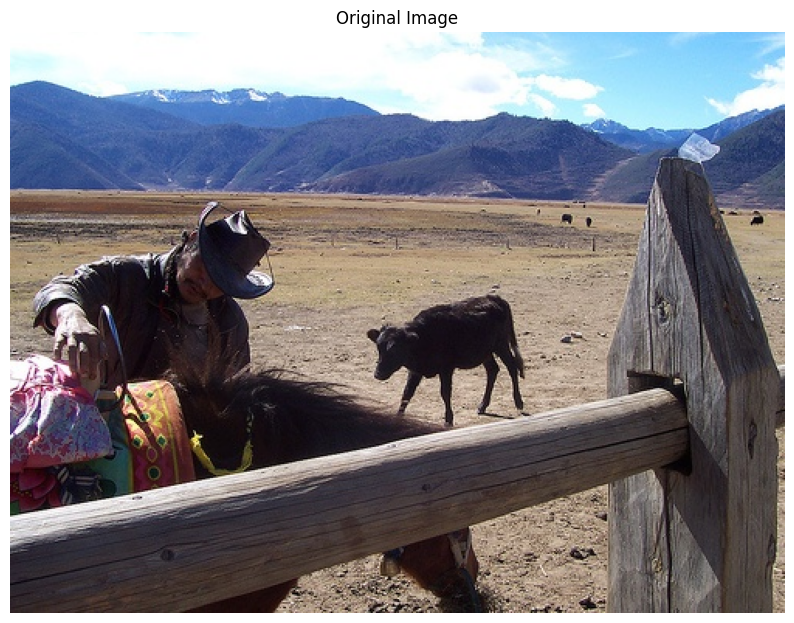

Found 3 ground truth annotations
Raw predictions: 0 boxes detected

All predictions (top 10):

After filtering (threshold=0.01): 0 boxes


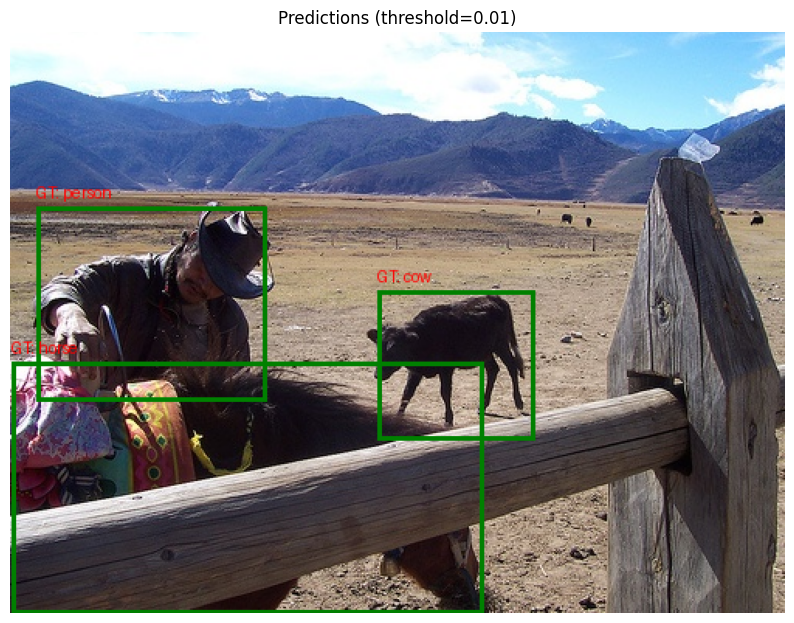

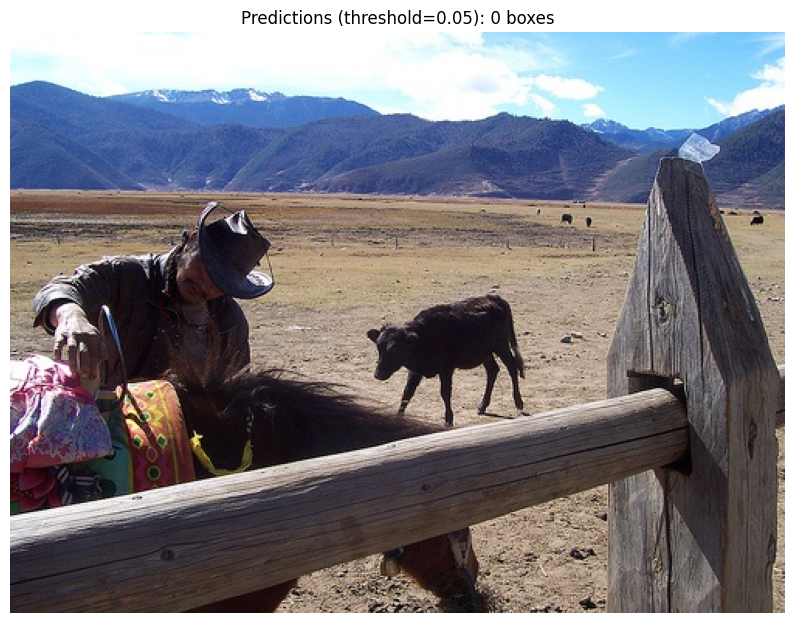

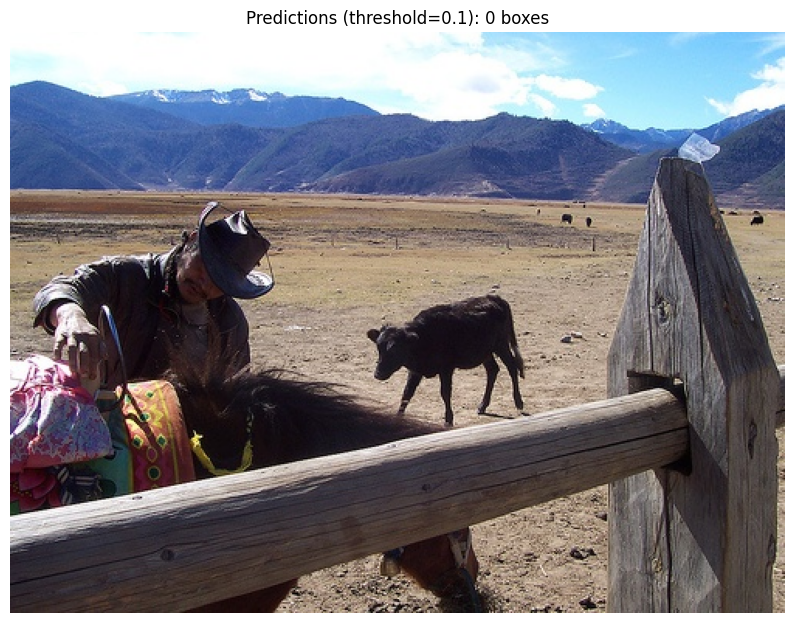

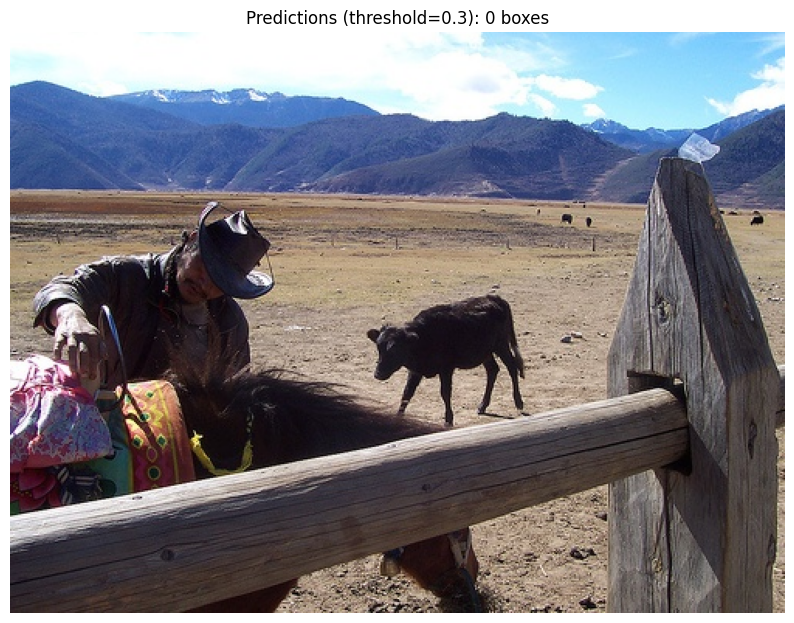


Model inspection:
Number of classes: 21
Score threshold: 0.05
NMS threshold: 0.5
Detections per image: 100

RoI Box Predictor:
FastRCNNPredictor(
  (cls_score): Linear(in_features=1024, out_features=21, bias=True)
  (bbox_pred): Linear(in_features=1024, out_features=84, bias=True)
)


In [39]:
import torch
import torchvision
import torchvision.transforms.functional as F
from PIL import Image, ImageDraw, ImageFont
import matplotlib.pyplot as plt
import json
import numpy as np
import os

# Define device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Load category information from COCO annotations
try:
    with open("/kaggle/input/g2-project/output_dataset/COCO/annotations/instances_test.json", 'r') as f:
        coco_data = json.load(f)
    
    # Create category ID to name mapping
    categories = {cat['id']: cat['name'] for cat in coco_data['categories']}
    print(f"Categories: {categories}")
except Exception as e:
    print(f"Error loading categories: {e}")
    # Fallback to generic labels
    categories = {i: f"Class {i}" for i in range(1, 21)}

# Load trained Faster R-CNN model
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=False)
num_classes = 21  # 20 classes + 1 background
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load trained model
model_path = "/kaggle/working/fasterrcnn_best.pth"
try:
    model.load_state_dict(torch.load(model_path, map_location=device))
    print(f"✅ Model loaded successfully from {model_path}")
except Exception as e:
    print(f"❌ Error loading model: {e}")

model.to(device)
model.eval()

# Function to process a single image
def process_single_image(image_path, confidence_threshold=0.5):
    print(f"Processing image: {image_path}")
    
    # Load image
    image = Image.open(image_path).convert("RGB")
    
    # Display original image
    plt.figure(figsize=(10, 10))
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis("off")
    plt.show()
    
    # Get ground truth annotations (if available)
    image_id = os.path.basename(image_path).split('.')[0]  # Assuming filename is the image_id
    gt_boxes = []
    gt_labels = []
    
    try:
        # Find annotations for this image
        image_info = next((img for img in coco_data['images'] if img['file_name'].endswith(f"{image_id}.jpg")), None)
        if image_info:
            image_id_int = image_info['id']
            annotations = [ann for ann in coco_data['annotations'] if ann['image_id'] == image_id_int]
            
            for ann in annotations:
                x, y, w, h = ann['bbox']
                gt_boxes.append([x, y, x+w, y+h])
                gt_labels.append(ann['category_id'])
            
            print(f"Found {len(annotations)} ground truth annotations")
    except Exception as e:
        print(f"Could not load ground truth annotations: {e}")
    
    # Apply transformations
    transform = torchvision.transforms.ToTensor()
    image_tensor = transform(image).unsqueeze(0).to(device)
    
    # Run inference
    with torch.no_grad():
        prediction = model(image_tensor)[0]
    
    # Print prediction stats
    pred_boxes = prediction['boxes'].cpu().numpy()
    pred_scores = prediction['scores'].cpu().numpy()
    pred_labels = prediction['labels'].cpu().numpy()
    
    print(f"Raw predictions: {len(pred_boxes)} boxes detected")
    
    # Show all predictions regardless of confidence
    print("\nAll predictions (top 10):")
    for i in range(min(10, len(pred_boxes))):
        label_id = pred_labels[i]
        label_name = categories.get(label_id, f"Class {label_id}")
        print(f"Box {i+1}: {label_name} (ID: {label_id}) - Score: {pred_scores[i]:.4f} - Coords: {pred_boxes[i]}")
    
    # Filter by confidence threshold
    filtered_indices = np.where(pred_scores >= confidence_threshold)[0]
    filtered_boxes = pred_boxes[filtered_indices]
    filtered_scores = pred_scores[filtered_indices]
    filtered_labels = pred_labels[filtered_indices]
    
    print(f"\nAfter filtering (threshold={confidence_threshold}): {len(filtered_boxes)} boxes")
    
    # Create a PIL image for drawing boxes
    result_img = image.copy()
    draw = ImageDraw.Draw(result_img)
    
    # Draw ground truth boxes in green
    for box, label in zip(gt_boxes, gt_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="green", width=3)
        draw.text((x_min, y_min-15), f"GT: {label_name}", fill="red")
    
    # Draw predicted boxes in red
    for box, score, label in zip(filtered_boxes, filtered_scores, filtered_labels):
        x_min, y_min, x_max, y_max = box
        label_name = categories.get(label, f"Class {label}")
        draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
        draw.text((x_min, y_min-15), f"Pred: {label_name} ({score:.2f})", fill="red")
    
    # Show the result
    plt.figure(figsize=(10, 10))
    plt.imshow(result_img)
    plt.title(f"Predictions (threshold={confidence_threshold})")
    plt.axis("off")
    plt.show()
    
    # Try multiple thresholds
    for threshold in [0.05, 0.1, 0.3]:
        if threshold == confidence_threshold:
            continue
            
        indices = np.where(pred_scores >= threshold)[0]
        boxes = pred_boxes[indices]
        scores = pred_scores[indices]
        labels = pred_labels[indices]
        
        # Create a new image for this threshold
        threshold_img = image.copy()
        draw = ImageDraw.Draw(threshold_img)
        
        # Draw boxes
        for box, score, label in zip(boxes, scores, labels):
            x_min, y_min, x_max, y_max = box
            label_name = categories.get(label, f"Class {label}")
            draw.rectangle([x_min, y_min, x_max, y_max], outline="red", width=3)
            draw.text((x_min, y_min-15), f"{label_name} ({score:.2f})", fill="red")
        
        # Show the result
        plt.figure(figsize=(10, 10))
        plt.imshow(threshold_img)
        plt.title(f"Predictions (threshold={threshold}): {len(boxes)} boxes")
        plt.axis("off")
        plt.show()
    
    return prediction

# Image path - replace with your actual test image path
image_path = "/kaggle/input/g2-project/output_dataset/images/test/2007_000904.jpg"

# Process the image with a low threshold to see all potential detections
results = process_single_image(image_path, confidence_threshold=0.01)

# Additional model inspection
print("\nModel inspection:")
print(f"Number of classes: {num_classes}")
print(f"Score threshold: {model.roi_heads.score_thresh}")
print(f"NMS threshold: {model.roi_heads.nms_thresh}")
print(f"Detections per image: {model.roi_heads.detections_per_img}")

# Check the box predictor and classifier
print("\nRoI Box Predictor:")
print(model.roi_heads.box_predictor)